In [2]:
from statsmodels.regression.rolling import RollingOLS
import pandas_datareader.data as web
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick 
import statsmodels.api as sm
from sklearn.manifold import TSNE
import pandas as pd
import numpy as np
import seaborn as sns
import datetime as dt
import yfinance as yf
import pandas_ta
import warnings
import math
warnings.filterwarnings('ignore')

## Data preprocessing

In [3]:
# read csv file
data = pd.read_csv('data.csv')
# convert date to datetime
data['date'] = pd.to_datetime(data['date'])
# convert ticker to category
data['ticker'] = data['ticker'].astype('category')
# set date and ticker as index
data = data.set_index(['date', 'ticker'])
data

atr   bb_high    bb_low    bb_mid  garman_klass_vol  \
date       ticker                                                             
2017-10-31 AAL     1.011062  3.994389  3.849110  3.921750         -0.000363   
           AAPL   -0.906642  3.692324  3.598569  3.645447         -0.000892   
           ABBV    0.375557  4.307973  4.215227  4.261600         -0.029822   
           ABT    -1.040044  3.949284  3.902136  3.925710         -0.004349   
           ACN    -0.986514  4.889486  4.810123  4.849805         -0.003359   
...                     ...       ...       ...       ...               ...   
2023-09-30 VZ     -1.078816  3.563843  3.499366  3.531604         -0.000067   
           WFC    -0.558742  3.798900  3.718132  3.758516          0.000234   
           WMT    -0.196379  5.116986  5.081613  5.099300          0.000024   
           XOM     0.601335  4.793504  4.713293  4.753399          0.000045   
           MRNA   -0.529511  4.788149  4.582514  4.685332          0.000146   

                       macd        rsi  1m_return  2m_return  3m_return  \
date       ticker                                                         
2017-10-31 AAL    -0.018697  41.051804  -0.014108   0.022981  -0.023860   
           AAPL   -0.039275  69.196794   0.096808   0.015250   0.044955   
           ABBV    0.473814  55.247867   0.022728   0.098590   0.091379   
           ABT     0.276132  53.844881   0.021275   0.034308   0.034801   
           ACN     0.352341  69.365427   0.064180   0.048455   0.037203   
...                     ...        ...        ...        ...        ...   
2023-09-30 VZ     -0.350385  42.222474  -0.056890  -0.016122  -0.033458   
           WFC    -0.282325  40.920273  -0.015500  -0.057917  -0.013554   
           WMT     0.399459  54.722508  -0.000676   0.010014   0.012354   
           XOM     1.400623  59.440192   0.046947   0.046139   0.030496   
           MRNA   -0.376899  38.747314  -0.132219  -0.086803  -0.068763   

                   6m_return  9m_return  12m_return    Mkt-RF       SMB  \
date       ticker                                                         
2017-10-31 AAL      0.016495   0.007008    0.012702  1.261817  1.306500   
           AAPL     0.028875   0.038941    0.035228  1.280256 -0.272362   
           ABBV     0.056495   0.047273    0.044026  0.495965  0.376214   
           ABT      0.038672   0.031320    0.029294  0.831881 -0.213284   
           ACN      0.028692   0.027398    0.018728  1.197481 -0.157158   
...                      ...        ...         ...       ...       ...   
2023-09-30 VZ      -0.021495  -0.014100   -0.006158  0.518740 -0.365188   
           WFC      0.016712   0.000702    0.003255  1.093985 -0.140008   
           WMT      0.017574   0.016553    0.020256  0.615232 -0.473891   
           XOM      0.012838   0.008747    0.027037  1.168320  0.387311   
           MRNA    -0.071952  -0.064976   -0.015431  1.301327 -0.186763   

                        HML       RMW       CMA  
date       ticker                                
2017-10-31 AAL     0.632023  0.507424  0.557001  
           AAPL   -0.609508  0.663831  0.487738  
           ABBV   -0.016727  0.231811  0.123746  
           ABT    -0.539413  0.236860  0.981359  
           ACN    -0.330355  0.264166  0.179182  
...                     ...       ...       ...  
2023-09-30 VZ      0.013464  0.313425  0.617455  
           WFC     1.309152 -0.750924 -0.409060  
           WMT    -0.291126  0.409352  0.729465  
           XOM     0.513399 -0.467914  0.799640  
           MRNA   -1.183057  1.125993  0.527068  

[10022 rows x 18 columns]

In [4]:
# create function to optimize portfolio for every month
def optimize_month(portfolio_df, fixed_dates, start_date, returns_dataframe, cluster_num):
    try:

        end_date = (pd.to_datetime(start_date)+pd.offsets.MonthEnd(0)).strftime('%Y-%m-%d')
        cols = fixed_dates[start_date]
        optimization_start_date = (pd.to_datetime(start_date)-pd.DateOffset(months=12)).strftime('%Y-%m-%d')
        optimization_end_date = (pd.to_datetime(start_date)-pd.DateOffset(days=1)).strftime('%Y-%m-%d')
        optimization_df = new_df[optimization_start_date:optimization_end_date]['Adj Close'][cols]
        success = False
        try:
            weights = optimize_weights(prices=optimization_df,
                                   lower_bound=round(1/(len(optimization_df.columns)*2),3))
#                                     lower_bound=-0.25)
            weights = pd.DataFrame(weights, index=pd.Series(0))
            success = True
        except:
            print(f'Max Sharpe Optimization failed for {start_date}, Continuing with Equal-Weights')
        
        if success==False:
            weights = pd.DataFrame([1/len(optimization_df.columns) for i in range(len(optimization_df.columns))],
                                     index=optimization_df.columns.tolist(),
                                     columns=pd.Series(0)).T
        
        temp_df = returns_dataframe[start_date:end_date]
        temp_df = temp_df.stack().to_frame('return').reset_index(level=0)\
                   .merge(weights.stack().to_frame('weight').reset_index(level=0, drop=True),
                          left_index=True,
                          right_index=True)\
                   .reset_index().set_index(['Date', 'index']).unstack().stack()

        temp_df.index.names = ['date', 'ticker']
        temp_df['weighted_return'] = temp_df['return']*temp_df['weight']    
        col_name = 'Strategy Return_' + str(cluster_num)
        temp_df = temp_df.groupby(level=0)['weighted_return'].sum().to_frame(col_name)
        portfolio_df = pd.concat([portfolio_df, temp_df], axis=0)
    
    except Exception as e:
        print(e)
    return portfolio_df

def optimize_all(dates, new_df, cluster_num):
    portfolio_df = pd.DataFrame()
    returns_dataframe = np.log(new_df['Adj Close']).diff()
    for start_date in dates.keys():
        portfolio_df = optimize_month(portfolio_df, dates, start_date, returns_dataframe, cluster_num)
    portfolio_df = portfolio_df.drop_duplicates()
    return portfolio_df

In [5]:
# functions to calculate key metrics
def calculate_geo_mean(df):
    geo_mean = (df+1).prod()**(1/df.shape[0]) - 1
    return geo_mean

def calculate_annul_vol(df):
    annul_vol = df.std()*np.sqrt(252)
    return annul_vol
    
def calculate_annul_ret(df):
    returns_per_day = calculate_geo_mean(df)
    annul_ret = (returns_per_day+1)**252-1
    return annul_ret

def calculate_sharpe_ratio(annualized_return, annualized_vol, riskfree_rate=0.02):
    return (annualized_return - riskfree_rate)/annualized_vol

def calculate_max_drawdown(return_series): 
    wealth_index = (1+return_series).cumprod()
    previous_peaks = wealth_index.cummax()
    drawdowns = (wealth_index - previous_peaks)/ previous_peaks
    
    return drawdowns.min()

## Preparing data for clustering

In [6]:
# It's a good practice to scale the data before clustering
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import AgglomerativeClustering
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)

In [7]:
# Visualize data_scaled the clusters using t-SNE
tsne = TSNE(n_components=2, random_state=42)
data_tsne = tsne.fit_transform(data_scaled)
data_tsne

array([[ 40.93269  ,  17.47293  ],
       [ 18.349506 ,  -1.8402529],
       [ 77.221756 ,  41.593327 ],
       ...,
       [-19.28713  , -28.202806 ],
       [  6.863325 , -29.131077 ],
       [-28.803205 ,  45.101284 ]], dtype=float32)

## For each month fit Agglomerative Clustering to group similar assets based on their features. Reiterate with different number of clusters from k=3 to 7

In [8]:
from sklearn.cluster import AgglomerativeClustering
def agglomerative_clusters(data_scaled, n_clusters=3):
    """
    Perform Agglomerative Clustering on the given data, scale it, and visualize the clusters using t-SNE.
    Parameters:
    - data (DataFrame): The data for clustering.
    - n_clusters (int, optional): The number of clusters to create (default is 3).
    - data_dict (dict, optional): Dictionary to store the resulting DataFrames (default is None).
    Returns:
    - DataFrame: The original DataFrame with a new 'cluster' column indicating the cluster assignments.
    """
    # Perform Agglomerative Clustering
    agg_clustering = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage='ward')
    clusters_agg = agg_clustering.fit_predict(data_scaled)

    # Add clusters to the original data
    data_with_clusters = data.copy()
    data_with_clusters[f'cluster_{n_clusters}'] = clusters_agg
    
    # Visualize the clusters using t-SNE
    tsne = TSNE(n_components=2, random_state=42)
    data_tsne = tsne.fit_transform(data_scaled)

    # Plot t-SNE Visualization of Agglomerative Clusters
    plt.figure(figsize=(8, 4))
    plt.scatter(data_tsne[:, 0], data_tsne[:, 1], c=data_with_clusters[f'cluster_{n_clusters}'], cmap='viridis', s=50)
    plt.colorbar()
    plt.title(f't-SNE Visualization of Agglomerative Clusters (k={n_clusters})')
    plt.show()

    # Display cluster counts
    print(data_with_clusters[f'cluster_{n_clusters}'].value_counts())

    return data_with_clusters

In [9]:
def plot_clusters_by_date(num_clusters):
    """
    Plot clusters by date for a specific number of clusters.
    Parameters:
    - num_clusters (int): The number of clusters to plot (3 to 9).
    Returns:
    - None: Displays the scatter plot for each date.
    """
    data = globals()[f'data_{num_clusters}']  # Get the appropriate DataFrame based on num_clusters
    colors = ['red', 'green', 'blue', 'orange', 'purple', 'pink', 'black', 'brown', 'hotpink']

    for date in data.index.get_level_values('date').unique().tolist():
        subset_data = data.xs(date, level=0)
        plt.title(f'Date {date}')
        for i in range(num_clusters):
            cluster_data = subset_data[subset_data[f'cluster_{num_clusters}'] == i]
            plt.scatter(cluster_data.iloc[:, 0], cluster_data.iloc[:, 6], color=colors[i], label=f'Cluster {i}')

        plt.legend()
        plt.xlabel('ATR')  
        plt.ylabel('RSI')  
        plt.show()

In [10]:
def extract_highest_rsi_clusters_each_month(num_clusters):
    """
    Extract the cluster with the highest mean RSI for each date in the DataFrame.
    Parameters:
    - num_clusters (int): The number of clusters (3 to 9).
    Returns:
    - dict: A dictionary where keys are dates and values are lists of selected stocks in the highest mean RSI cluster.
    """

    # Get the appropriate DataFrame based on num_clusters
    data = globals()[f'data_{num_clusters}']

    # Reset the index and adjust the date by one day
    temp_df = data.reset_index()
    temp_df['date'] = temp_df['date'] + pd.DateOffset(1)
    
    # Get unique dates and initialize the result dictionary
    dates = pd.to_datetime(temp_df['date'].unique()).tolist()
    fixed_dates = {}

    for date in dates:
        # Filter the DataFrame for the current date
        filtered_df = temp_df[temp_df['date'] == date]
        cluster_column = f'cluster_{num_clusters}'
        rsi_column = 'rsi'
        # Calculate the mean RSI for each cluster on the current date
        cluster_means = filtered_df.groupby(cluster_column)[rsi_column].mean()
        # Find the cluster with the highest mean RSI
        highest_mean_cluster = cluster_means.idxmax()
        # Select the stocks in the highest mean RSI cluster
        selected_stocks = filtered_df[filtered_df[cluster_column] == highest_mean_cluster]['ticker']
        # Store the selected stocks in the result dictionary
        fixed_dates[date.strftime('%Y-%m-%d')] = list(selected_stocks)

    return fixed_dates

### When K=3

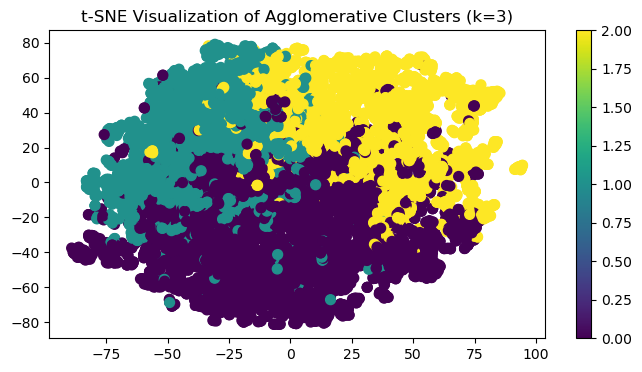

0    4599
2    2946
1    2477
Name: cluster_3, dtype: int64


In [11]:
data_3 = agglomerative_clusters(data_scaled, n_clusters=3)

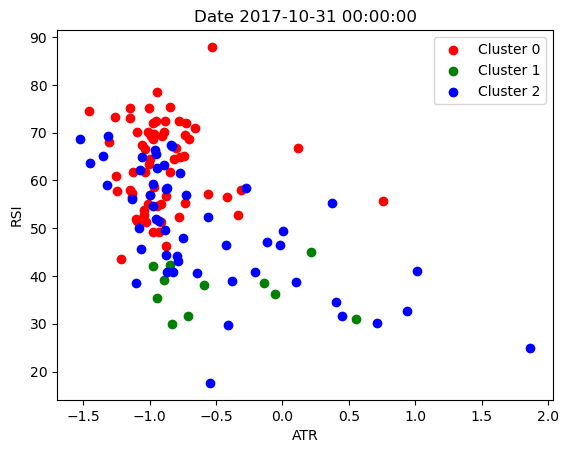

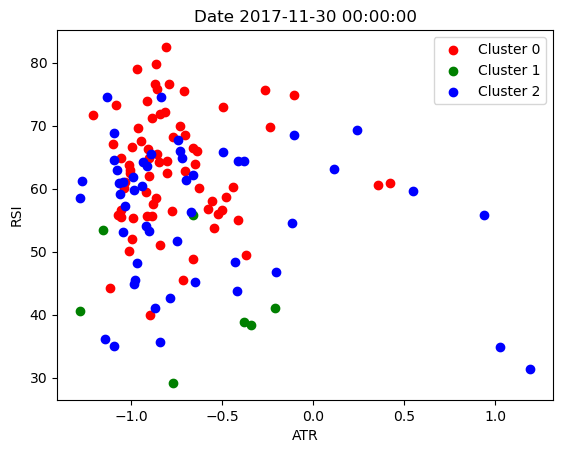

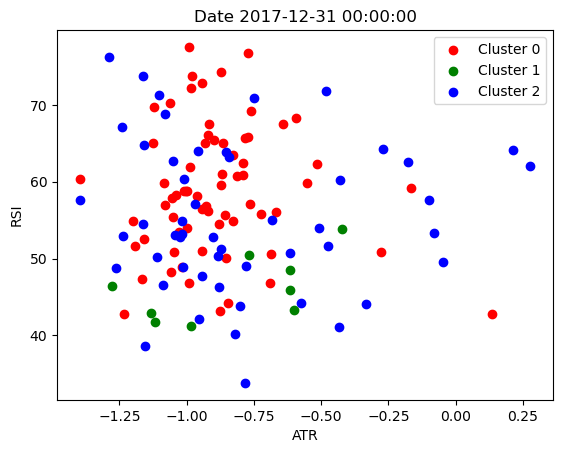

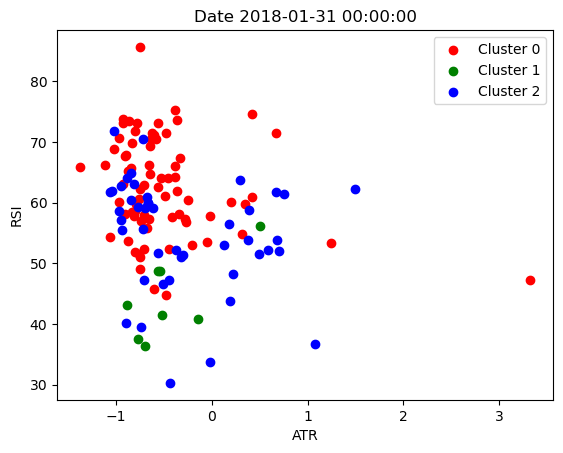

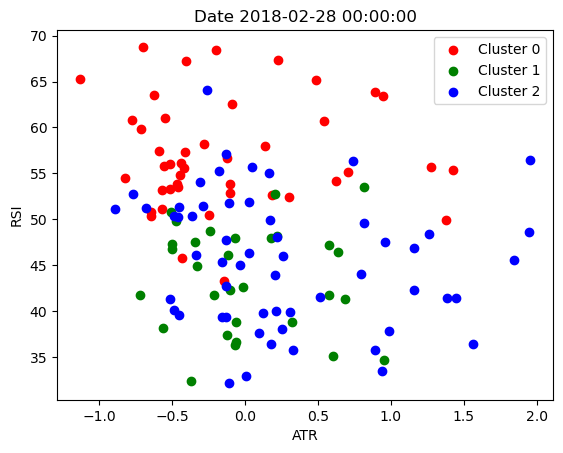

...

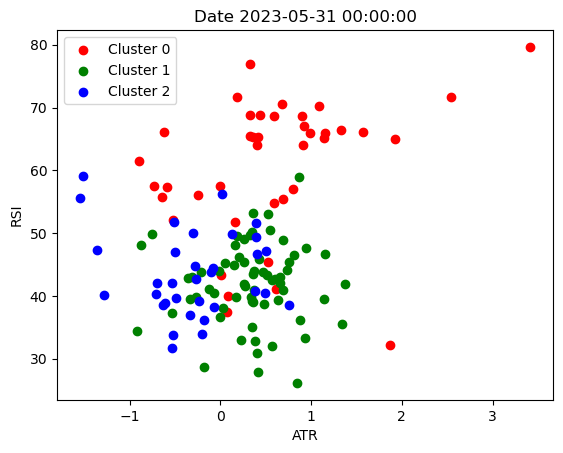

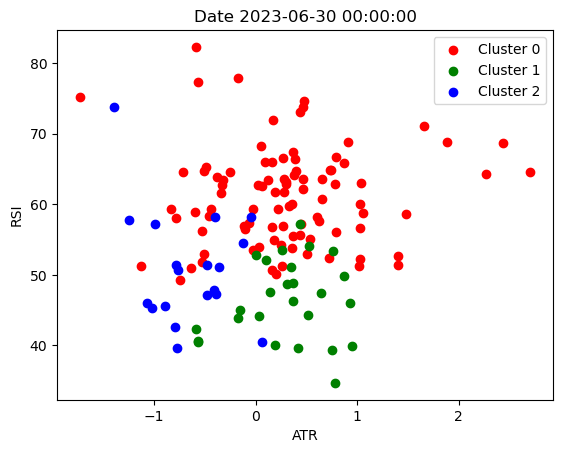

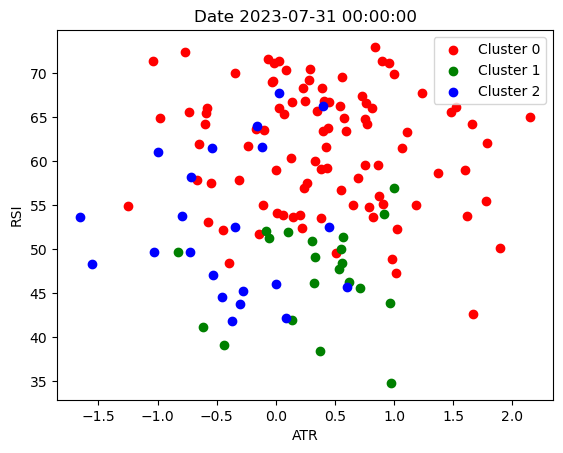

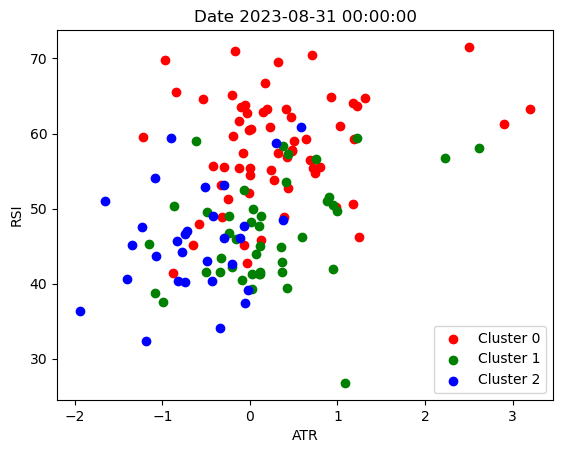

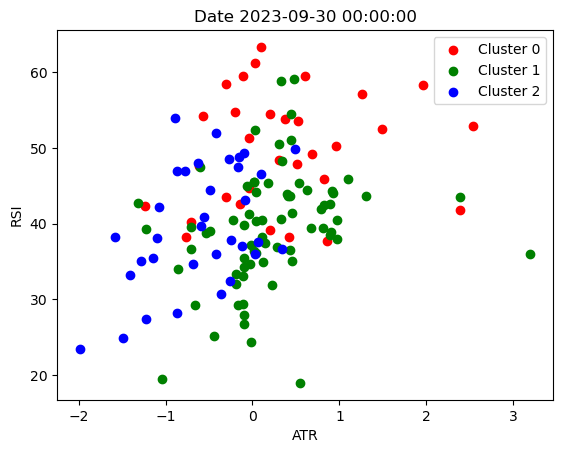

In [12]:
plot_clusters_by_date(num_clusters=3)

In [13]:
date_to_optimize_3 = extract_highest_rsi_clusters_each_month(num_clusters=3)
date_to_optimize_3

{'2017-11-01': ['AAPL',
  'ABT',
  'ACN',
  'ADBE',
  'AMAT',
  'AMZN',
  'AVGO',
  'AXP',
  'AZO',
  'BA',
  'BKNG',
  'BRK-B',
  'CAT',
  'COST',
  'CRM',
  'CSCO',
  'CTSH',
  'DD',
  'DE',
  'DG',
  'DHR',
  'DIS',
  'DLTR',
  'EA',
  'ELV',
  'FDX',
  'GM',
  'GS',
  'HD',
  'HON',
  'HUM',
  'ILMN',
  'INTC',
  'ISRG',
  'JNJ',
  'JPM',
  'LMT',
  'LOW',
  'MA',
  'MAR',
  'MCD',
  'META',
  'MMM',
  'MSFT',
  'MU',
  'NFLX',
  'NKE',
  'NVDA',
  'NXPI',
  'ORLY',
  'PANW',
  'PYPL',
  'SHW',
  'STZ',
  'TGT',
  'TMO',
  'TXN',
  'UNH',
  'UNP',
  'UPS',
  'V',
  'WDC',
  'WMT',
  'WYNN'],
 '2017-12-01': ['AAL',
  'AAPL',
  'ABT',
  'ACN',
  'ADBE',
  'AMZN',
  'AVGO',
  'AXP',
  'AZO',
  'BA',
  'BKNG',
  'BRK-B',
  'CAT',
  'CMG',
  'COST',
  'CRM',
  'CSCO',
  'CTSH',
  'CVS',
  'DD',
  'DE',
  'DG',
  'DHR',
  'DIS',
  'DLTR',
  'ELV',
  'FDX',
  'GM',
  'GS',
  'HD',
  'HON',
  'HUM',
  'ILMN',
  'INTC',
  'ISRG',
  'JNJ',
  'JPM',
  'KR',
  'LLY',
  'LMT',
  'LOW',
  'MA',


### When N=4

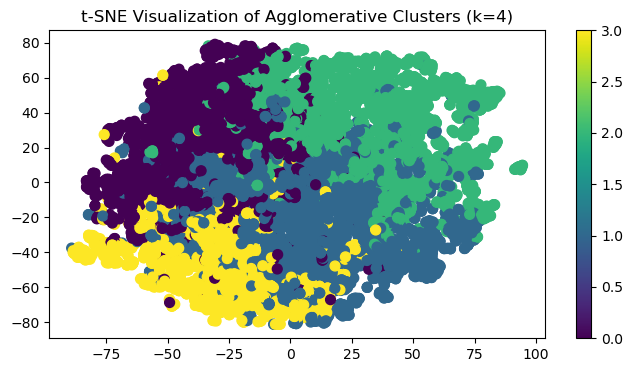

1    3122
2    2946
0    2477
3    1477
Name: cluster_4, dtype: int64


In [14]:
data_4 = agglomerative_clusters(data_scaled, n_clusters=4)

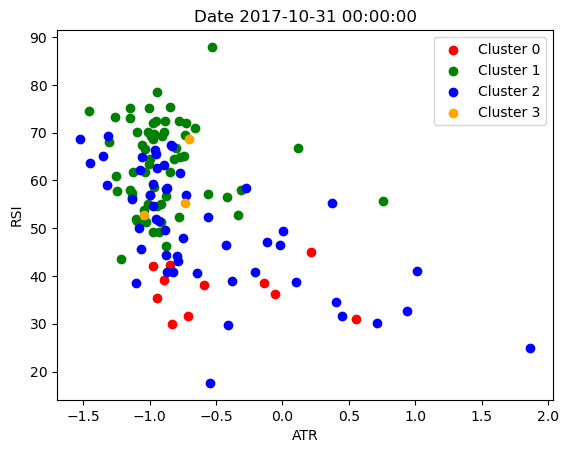

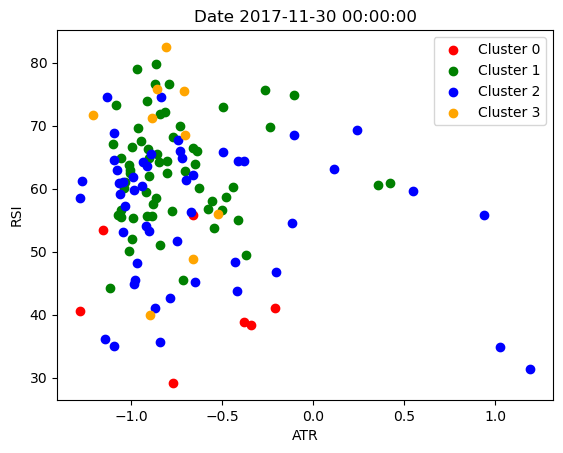

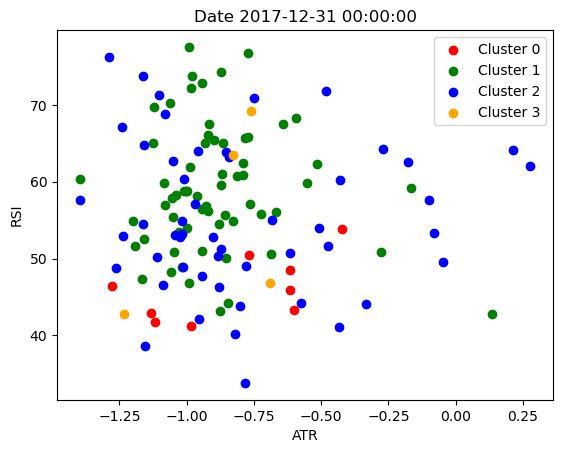

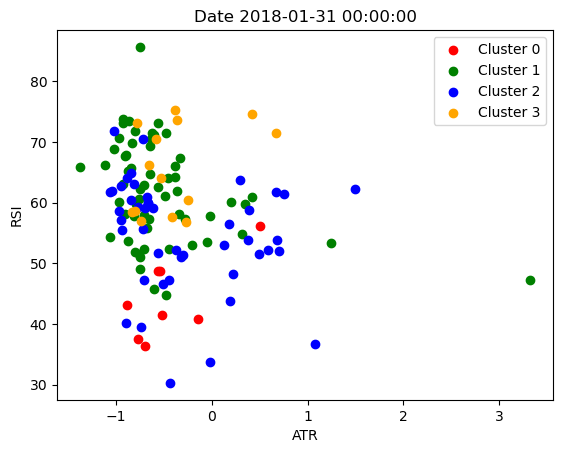

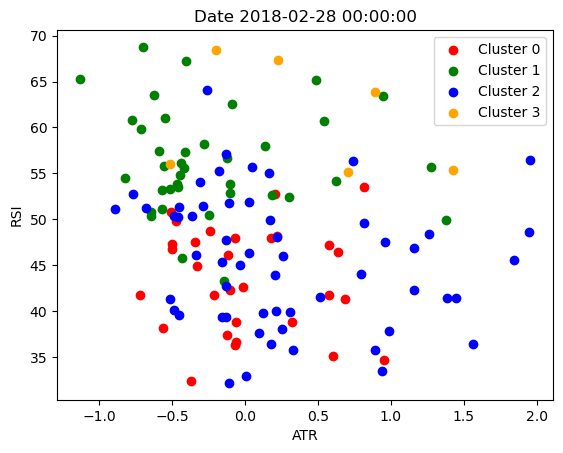

...

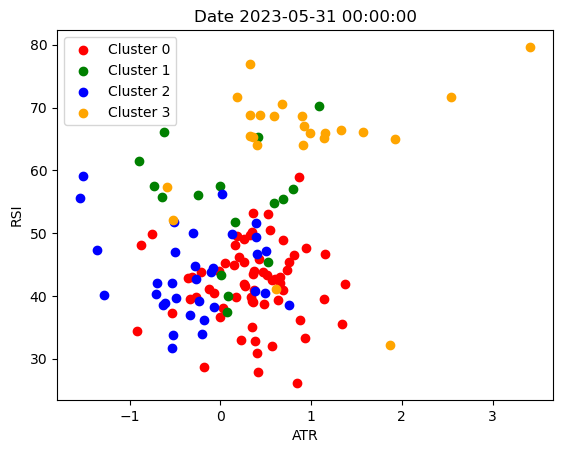

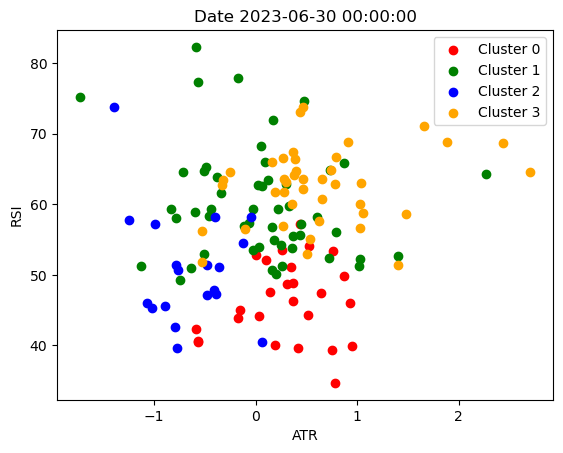

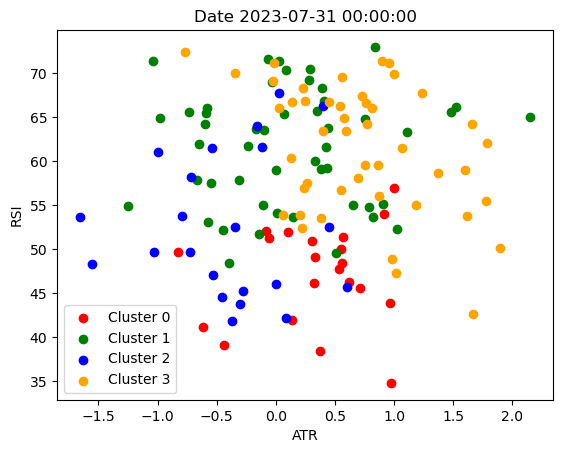

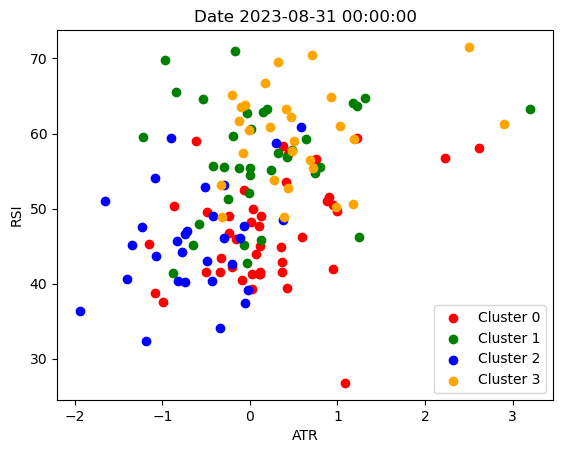

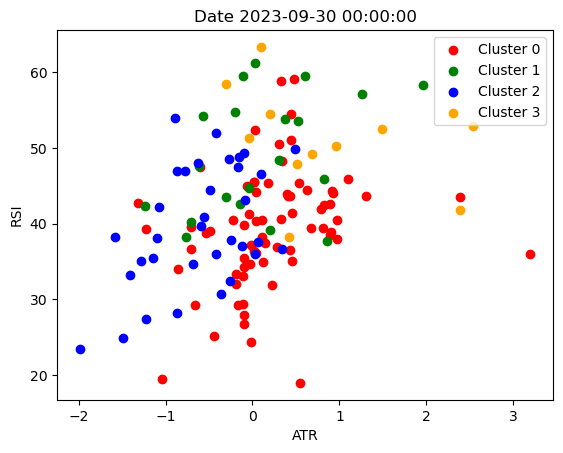

In [15]:
plot_clusters_by_date(num_clusters=4)

In [16]:
date_to_optimize_4 = extract_highest_rsi_clusters_each_month(num_clusters=4)

### When N=5

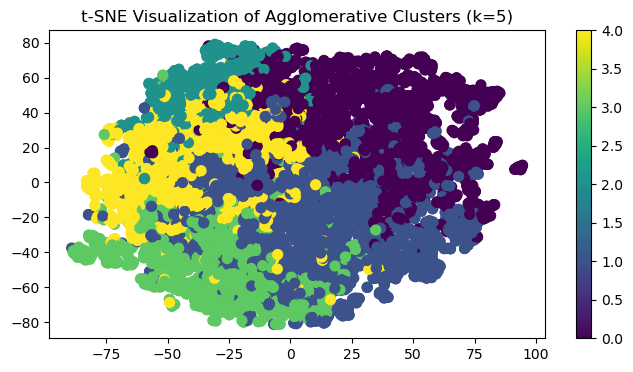

1    3122
0    2946
4    1790
3    1477
2     687
Name: cluster_5, dtype: int64


In [17]:
data_5 = agglomerative_clusters(data_scaled, n_clusters=5)

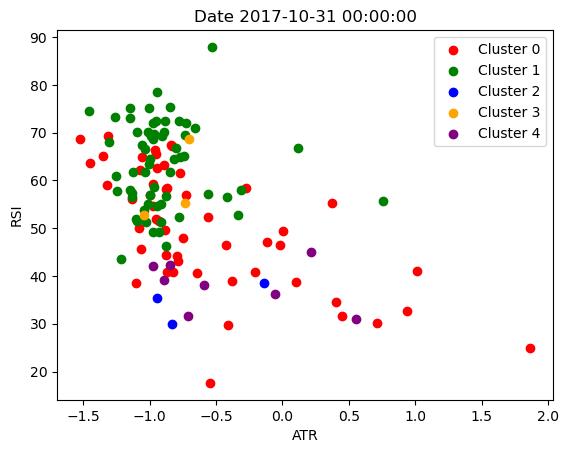

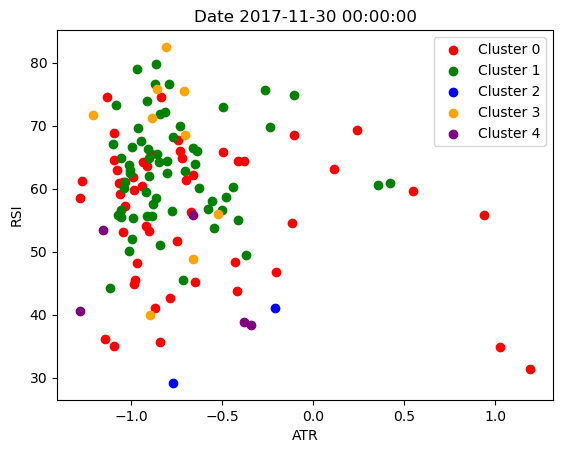

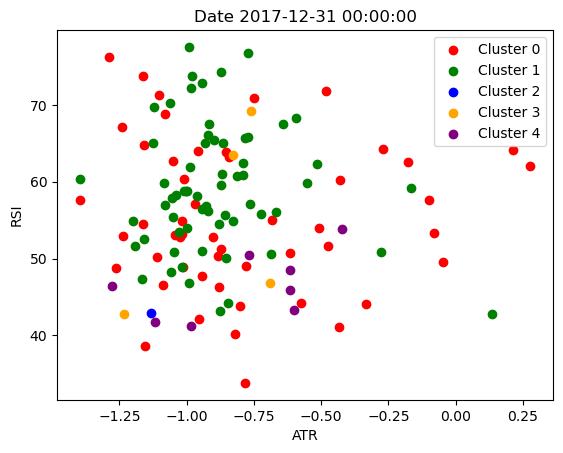

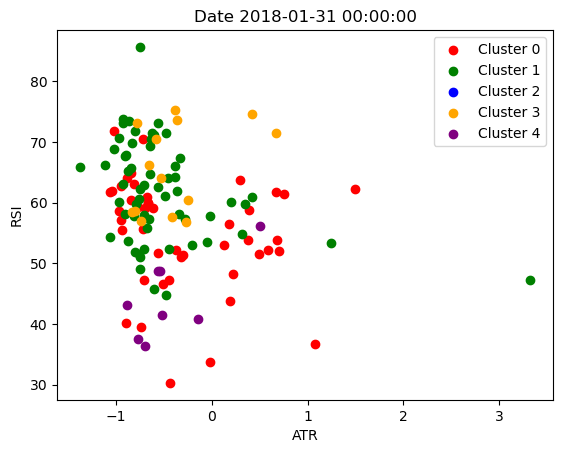

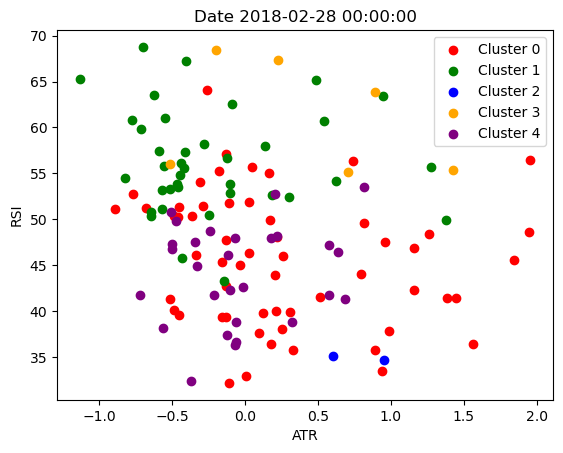

...

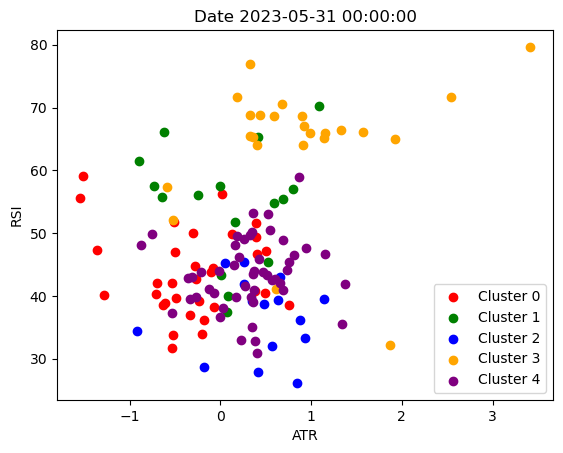

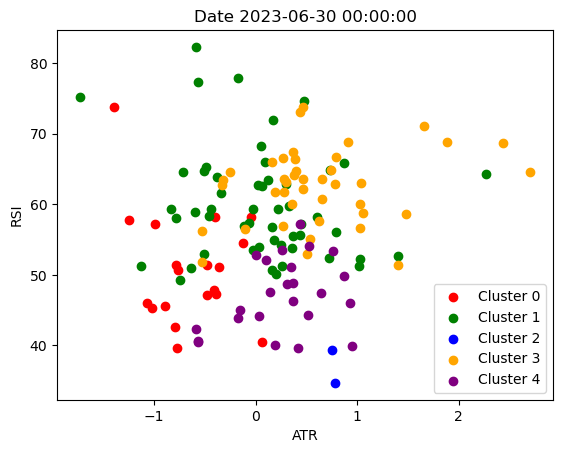

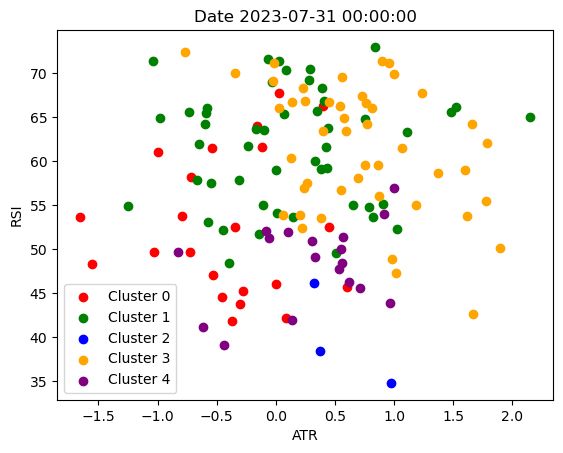

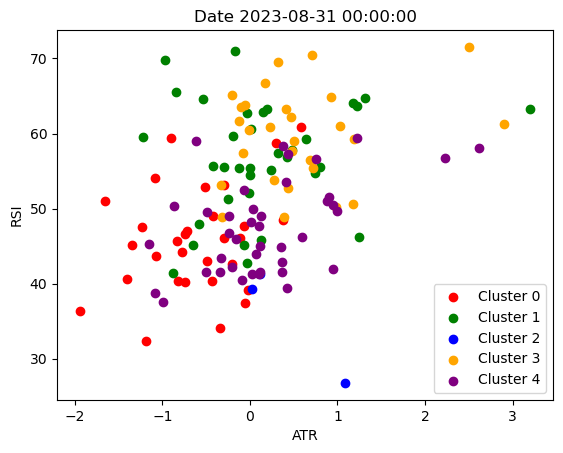

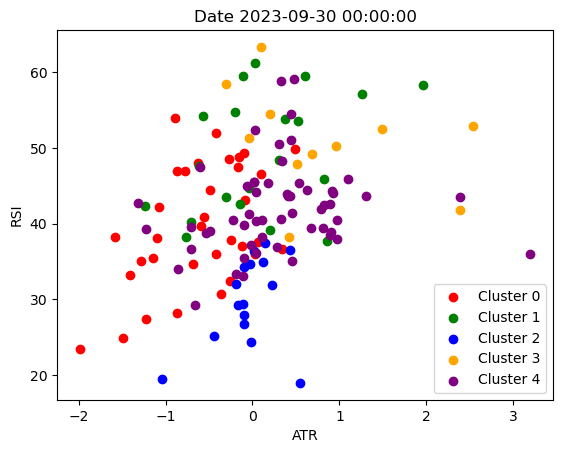

In [18]:
plot_clusters_by_date(num_clusters=5)

In [19]:
date_to_optimize_5 = extract_highest_rsi_clusters_each_month(num_clusters=5)

### When N=6

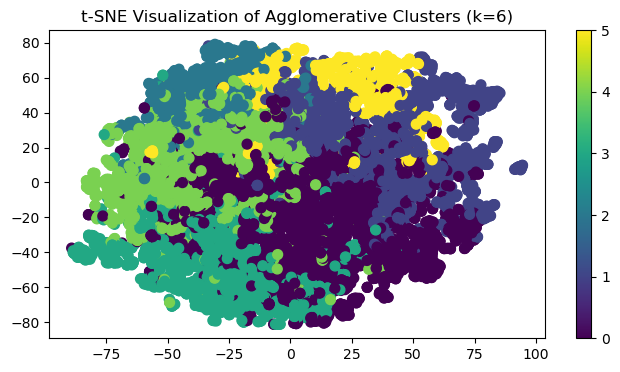

0    3122
1    2213
4    1790
3    1477
5     733
2     687
Name: cluster_6, dtype: int64


In [20]:
data_6 = agglomerative_clusters(data_scaled, n_clusters=6)

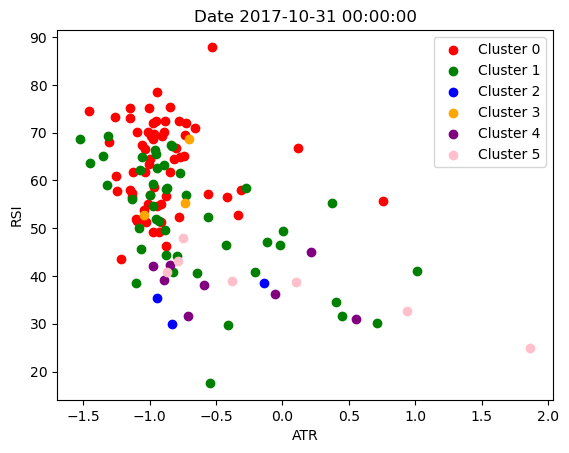

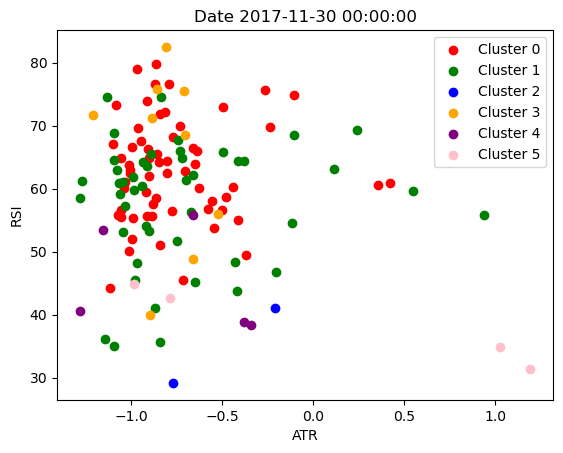

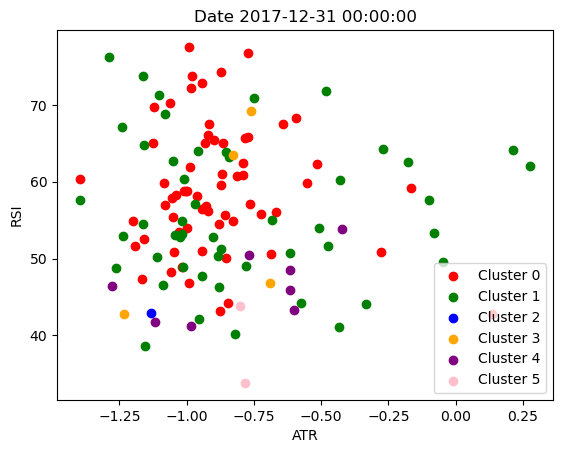

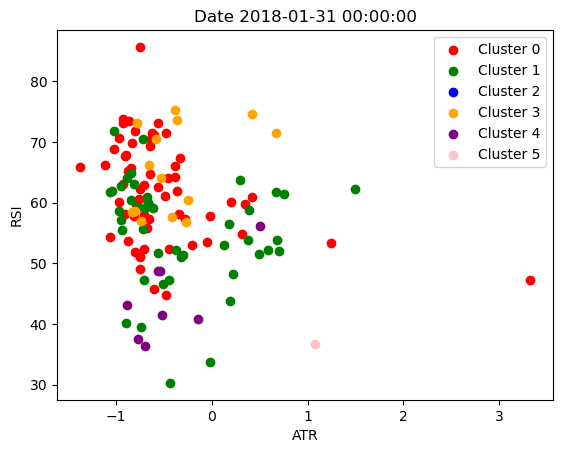

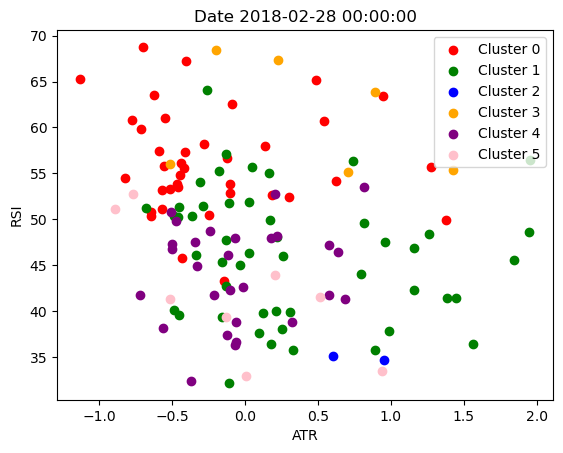

...

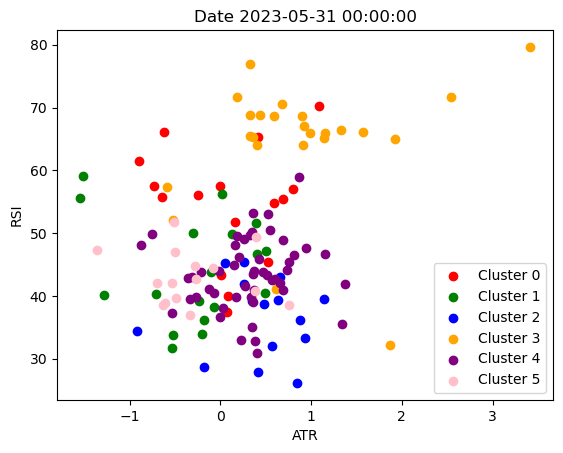

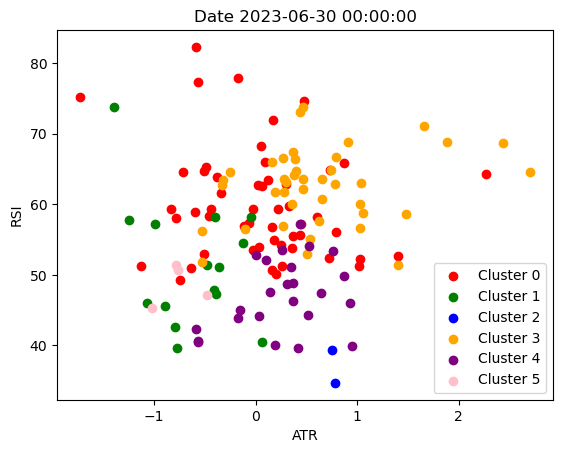

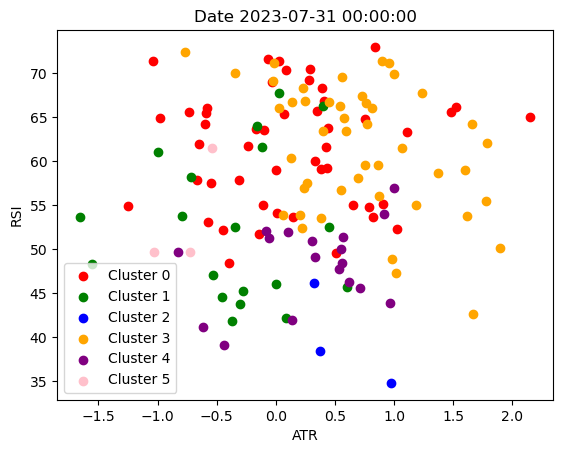

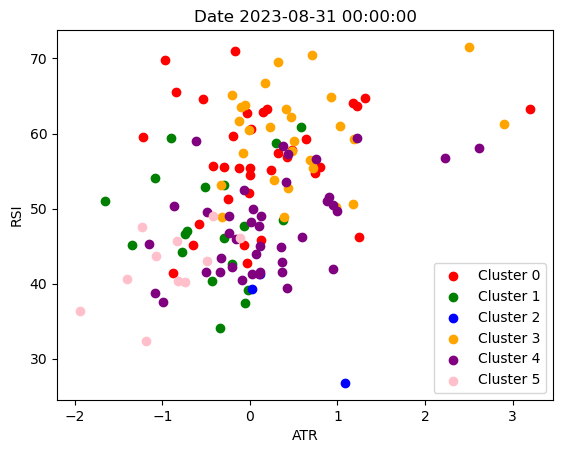

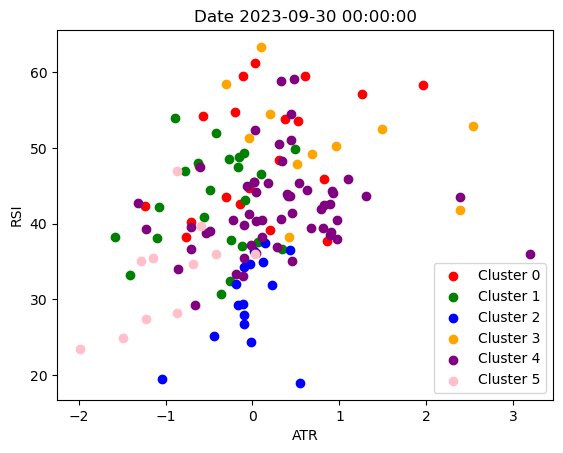

In [21]:
plot_clusters_by_date(num_clusters=6)

In [22]:
date_to_optimize_6 = extract_highest_rsi_clusters_each_month(num_clusters=6)

{'2017-11-01': ['AAPL',
  'ABT',
  'ACN',
  'ADBE',
  'AMAT',
  'AMZN',
  'AVGO',
  'AXP',
  'AZO',
  'BRK-B',
  'CAT',
  'COST',
  'CRM',
  'CSCO',
  'CTSH',
  'DD',
  'DE',
  'DG',
  'DHR',
  'DIS',
  'DLTR',
  'EA',
  'FDX',
  'GM',
  'GS',
  'HD',
  'HON',
  'HUM',
  'ILMN',
  'INTC',
  'ISRG',
  'JNJ',
  'JPM',
  'LMT',
  'LOW',
  'MA',
  'MAR',
  'MCD',
  'META',
  'MMM',
  'MSFT',
  'MU',
  'NFLX',
  'NKE',
  'NVDA',
  'NXPI',
  'ORLY',
  'PANW',
  'PYPL',
  'SHW',
  'STZ',
  'TGT',
  'TMO',
  'TXN',
  'UNH',
  'UNP',
  'UPS',
  'V',
  'WDC',
  'WMT',
  'WYNN'],
 '2017-12-01': ['AZO',
  'BA',
  'BKNG',
  'ELV',
  'ILMN',
  'NVDA',
  'ORLY',
  'STZ',
  'UNH'],
 '2018-01-01': ['AAL',
  'ABT',
  'ACN',
  'ADBE',
  'AMZN',
  'AXP',
  'BRK-B',
  'CAT',
  'CHTR',
  'COST',
  'CRM',
  'CSCO',
  'CTSH',
  'DD',
  'DE',
  'DG',
  'DHR',
  'DIS',
  'DLTR',
  'EBAY',
  'ELV',
  'FCX',
  'FDX',
  'GS',
  'HD',
  'HON',
  'ILMN',
  'INTC',
  'ISRG',
  'JNJ',
  'JPM',
  'KR',
  'LLY',
  'LMT'

### When N=7

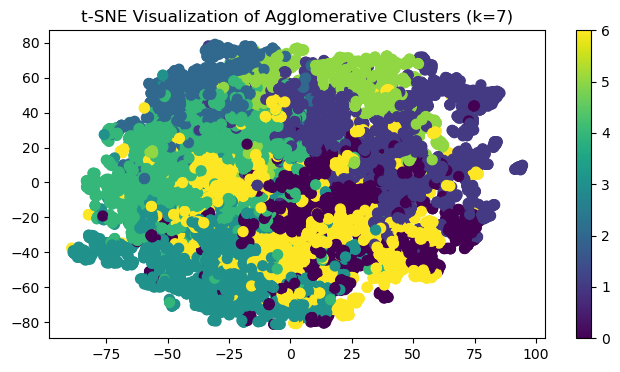

1    2213
4    1790
6    1761
3    1477
0    1361
5     733
2     687
Name: cluster_7, dtype: int64


In [23]:
data_7 = agglomerative_clusters(data_scaled, n_clusters=7)

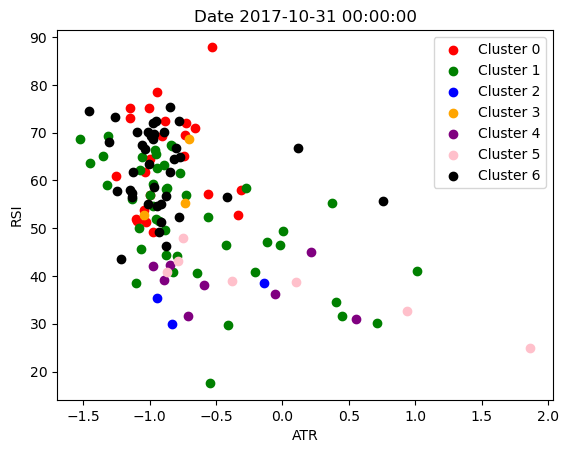

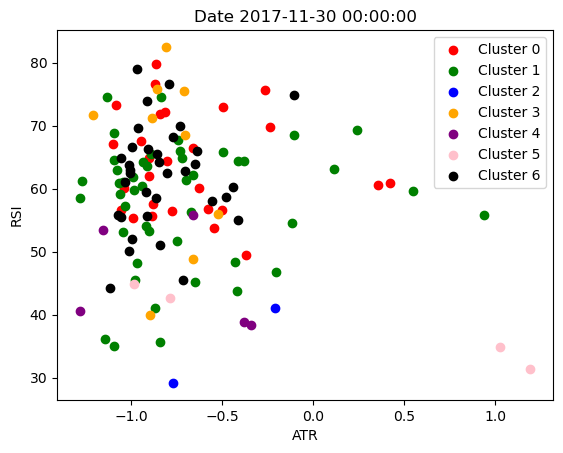

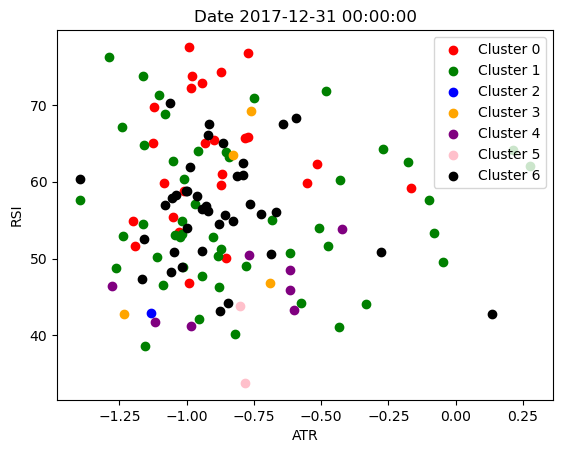

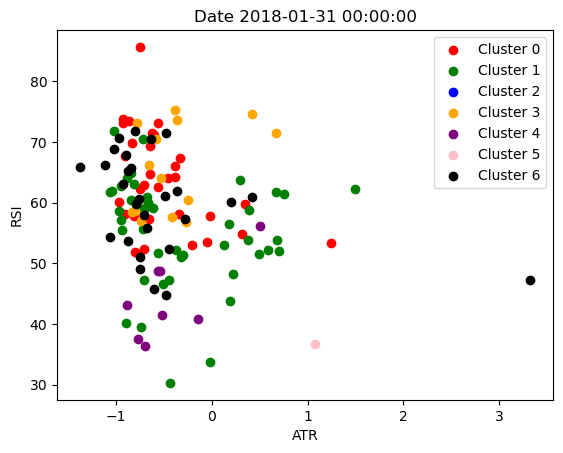

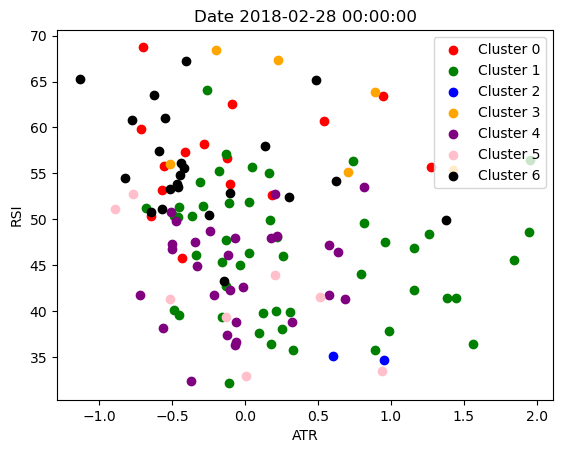

...

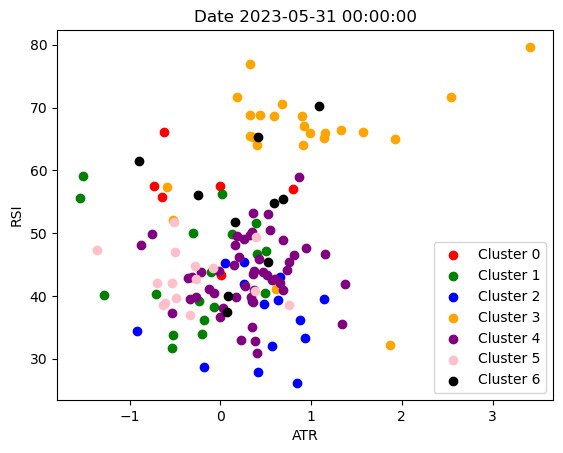

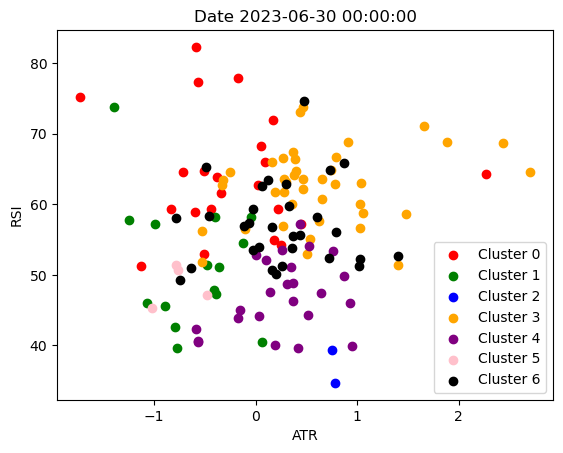

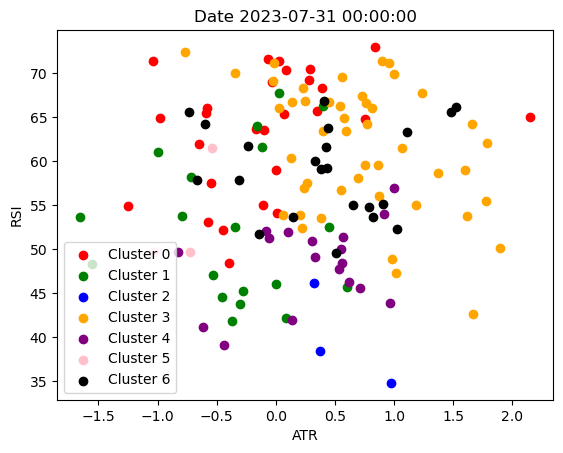

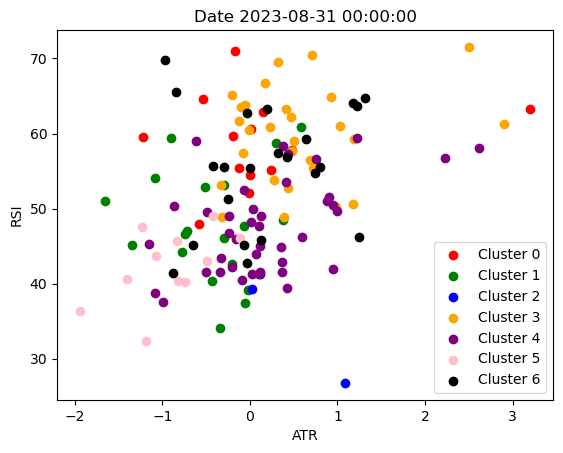

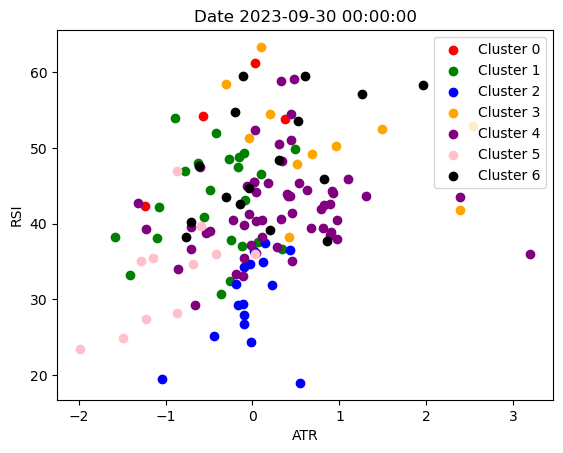

In [24]:
plot_clusters_by_date(num_clusters=7)

In [25]:
date_to_optimize_7 = extract_highest_rsi_clusters_each_month(num_clusters=7)

{'2017-11-01': ['AAPL',
  'ABT',
  'AMAT',
  'AMZN',
  'CAT',
  'CSCO',
  'DD',
  'DG',
  'DLTR',
  'EA',
  'GM',
  'ILMN',
  'INTC',
  'JNJ',
  'LOW',
  'MAR',
  'MSFT',
  'MU',
  'NKE',
  'NVDA',
  'TGT',
  'TXN',
  'WMT'],
 '2017-12-01': ['AZO',
  'BA',
  'BKNG',
  'ELV',
  'ILMN',
  'NVDA',
  'ORLY',
  'STZ',
  'UNH'],
 '2018-01-01': ['AAL',
  'ABT',
  'CAT',
  'CSCO',
  'DD',
  'DE',
  'DG',
  'DLTR',
  'EBAY',
  'FCX',
  'HD',
  'ILMN',
  'INTC',
  'JNJ',
  'KR',
  'LLY',
  'LOW',
  'MAR',
  'NKE',
  'PEP',
  'PG',
  'QCOM',
  'TGT',
  'TXN',
  'WMT'],
 '2018-02-01': ['AZO',
  'BA',
  'BKNG',
  'BRK-B',
  'CHTR',
  'EA',
  'ELV',
  'FDX',
  'HUM',
  'LMT',
  'NFLX',
  'ORLY',
  'TMO',
  'UNH'],
 '2018-03-01': ['BA', 'BKNG', 'BMY', 'EA', 'NFLX', 'NVDA'],
 '2018-04-01': ['DG', 'ILMN', 'INTC', 'MU', 'NKE', 'TGT'],
 '2018-05-01': ['BA', 'BKNG', 'CMG', 'ELV', 'NFLX', 'NVDA', 'ULTA', 'UNH'],
 '2018-06-01': ['AAPL',
  'ABT',
  'AMGN',
  'AMT',
  'EXPE',
  'GM',
  'INTC',
  'LLY',
  'LOW

### When N=8

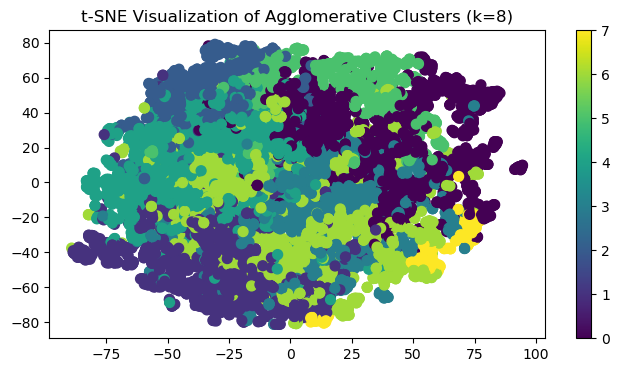

0    2213
4    1790
6    1761
1    1477
3    1150
5     733
2     687
7     211
Name: cluster_8, dtype: int64


In [27]:
data_8 = agglomerative_clusters(data_scaled, 8)

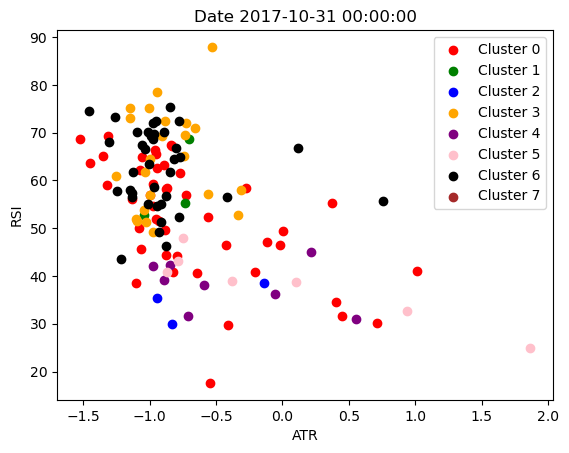

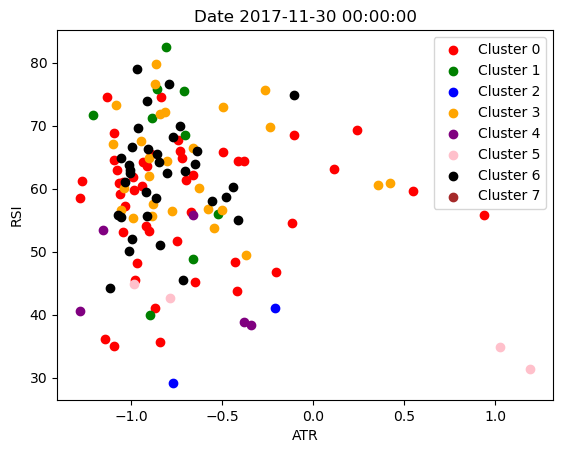

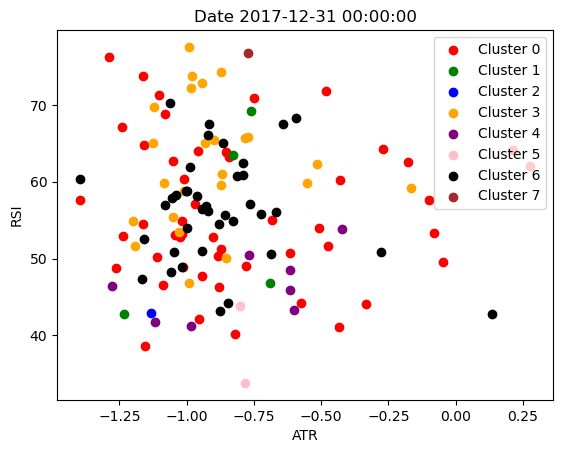

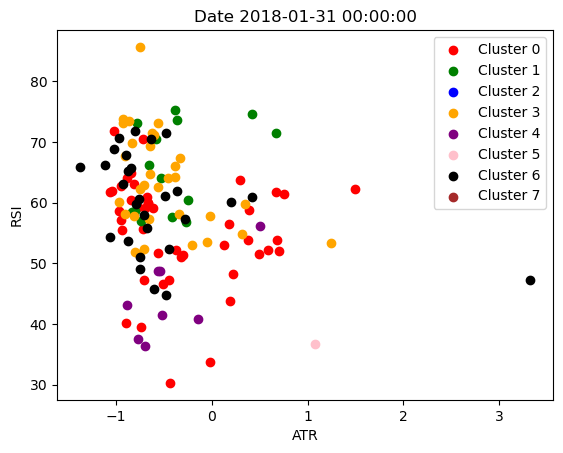

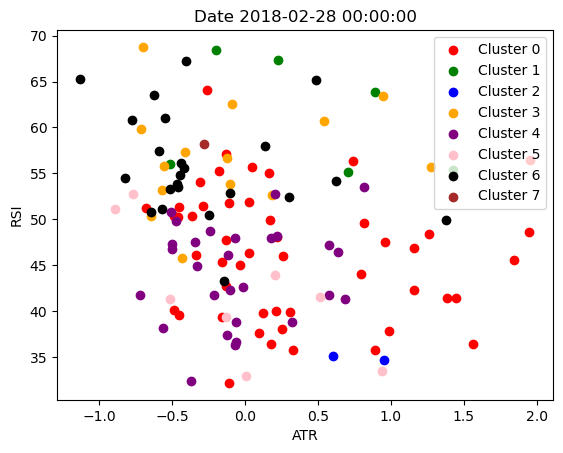

...

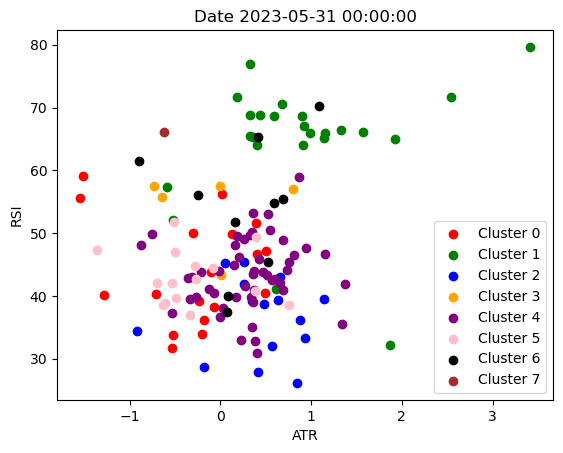

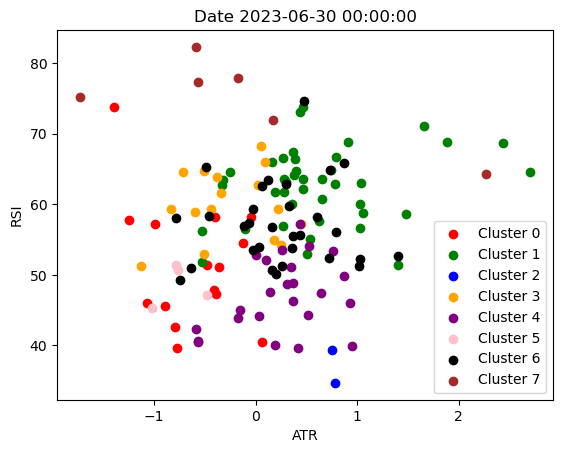

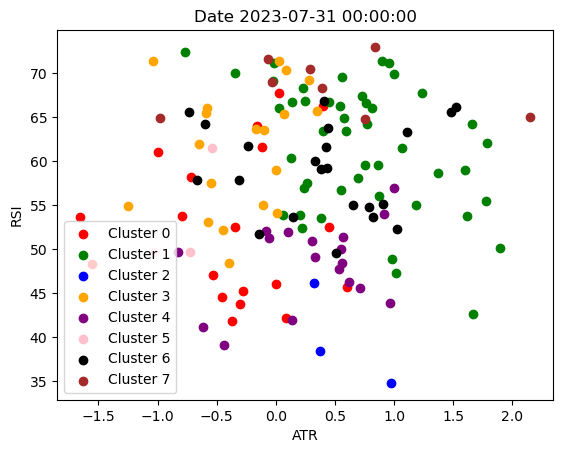

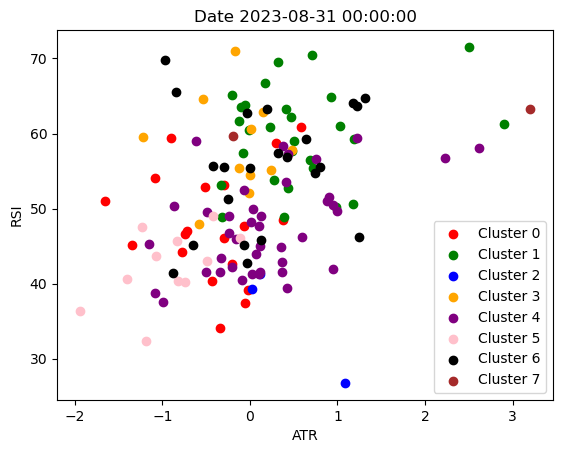

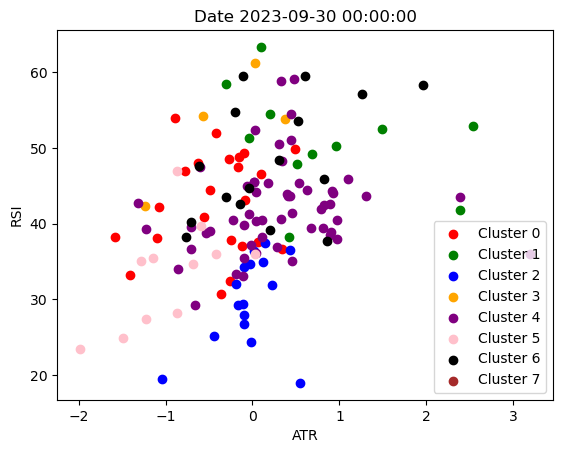

In [28]:
plot_clusters_by_date(num_clusters=8)

In [29]:
date_to_optimize_8= extract_highest_rsi_clusters_each_month(num_clusters=8)

{'2017-11-01': ['AAPL',
  'ABT',
  'AMAT',
  'AMZN',
  'CAT',
  'CSCO',
  'DD',
  'DG',
  'DLTR',
  'EA',
  'GM',
  'ILMN',
  'INTC',
  'JNJ',
  'LOW',
  'MAR',
  'MSFT',
  'MU',
  'NKE',
  'NVDA',
  'TGT',
  'TXN',
  'WMT'],
 '2017-12-01': ['AZO',
  'BA',
  'BKNG',
  'ELV',
  'ILMN',
  'NVDA',
  'ORLY',
  'STZ',
  'UNH'],
 '2018-01-01': ['FCX'],
 '2018-02-01': ['AZO',
  'BA',
  'BKNG',
  'BRK-B',
  'CHTR',
  'EA',
  'ELV',
  'FDX',
  'HUM',
  'LMT',
  'NFLX',
  'ORLY',
  'TMO',
  'UNH'],
 '2018-03-01': ['BA', 'BKNG', 'BMY', 'EA', 'NFLX', 'NVDA'],
 '2018-04-01': ['DG', 'ILMN', 'INTC', 'MU', 'NKE', 'TGT'],
 '2018-05-01': ['BA', 'BKNG', 'CMG', 'ELV', 'NFLX', 'NVDA', 'ULTA', 'UNH'],
 '2018-06-01': ['AAPL',
  'ABT',
  'AMGN',
  'AMT',
  'EXPE',
  'GM',
  'INTC',
  'LLY',
  'LOW',
  'MDT',
  'MRK',
  'MU',
  'NKE',
  'TGT',
  'TJX',
  'TXN'],
 '2018-07-01': ['AMGN',
  'AMT',
  'BMY',
  'DG',
  'EXPE',
  'ILMN',
  'KR',
  'LLY',
  'LOW',
  'MRK',
  'NKE',
  'PEP',
  'PG',
  'TGT',
  'TJX',
 

### When N=9

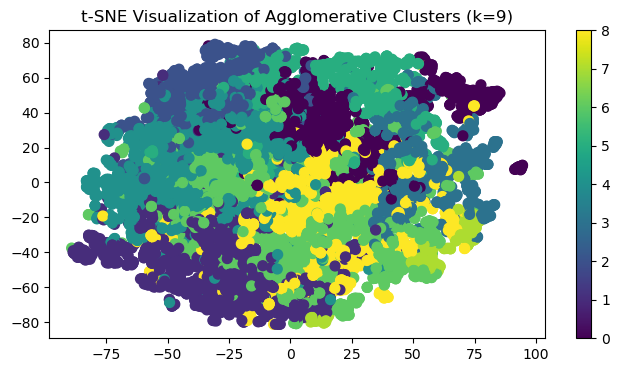

4    1790
6    1761
1    1477
0    1210
8    1150
3    1003
5     733
2     687
7     211
Name: cluster_9, dtype: int64


In [31]:
data_9 = agglomerative_clusters(data_scaled, 9)

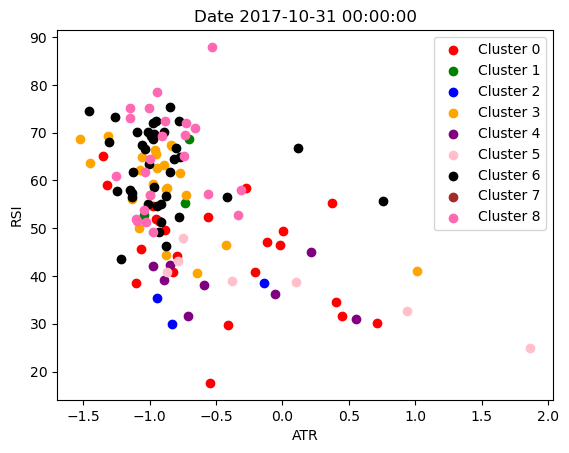

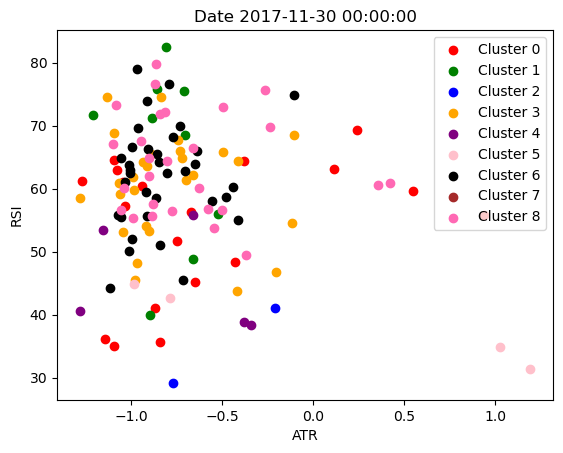

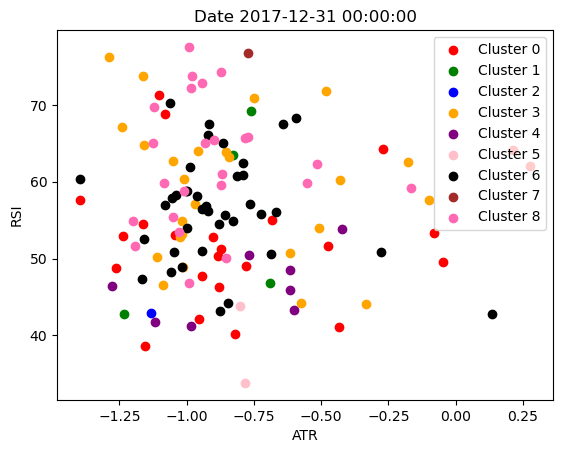

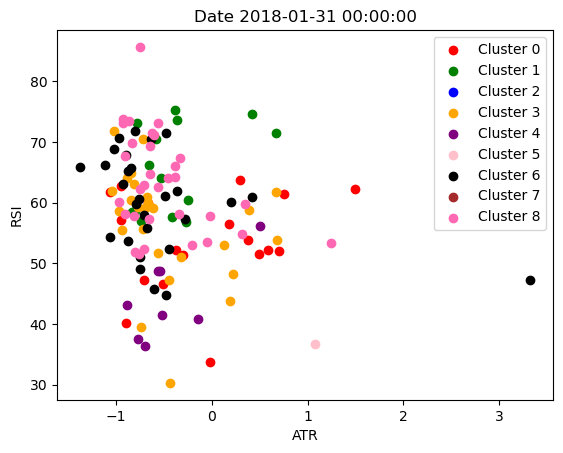

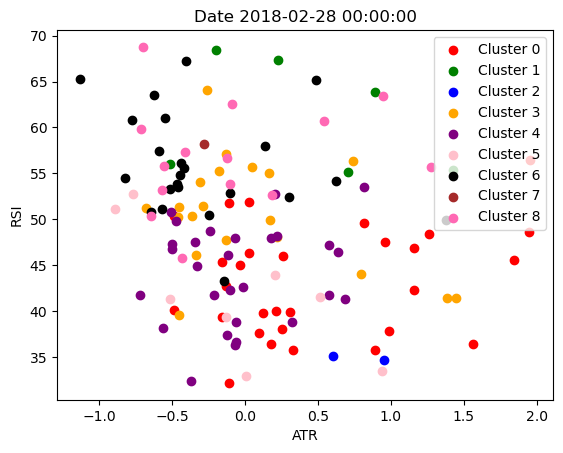

...

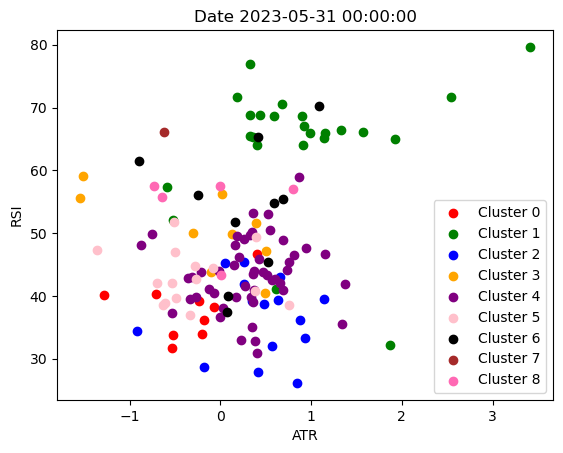

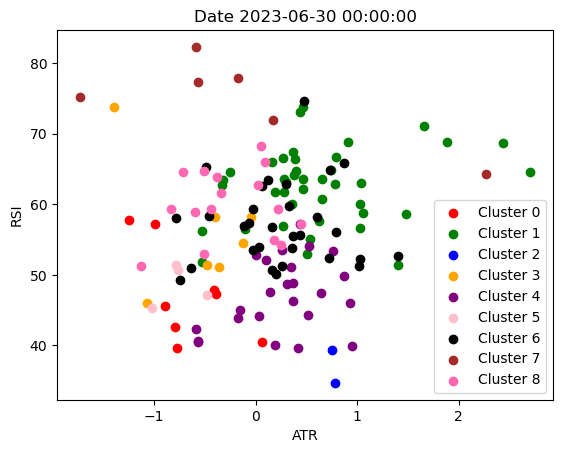

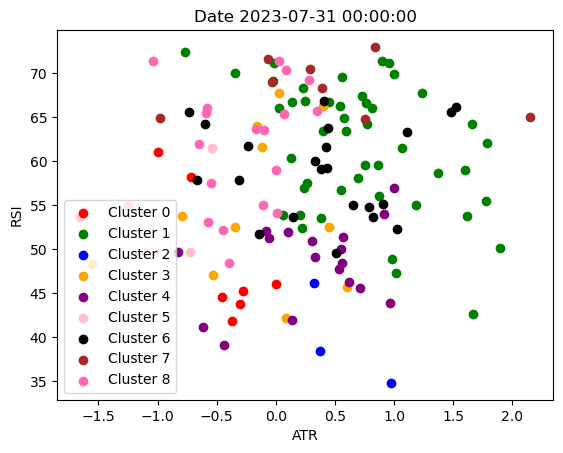

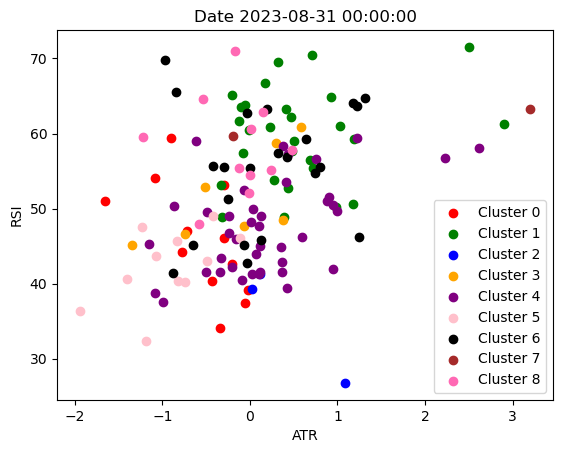

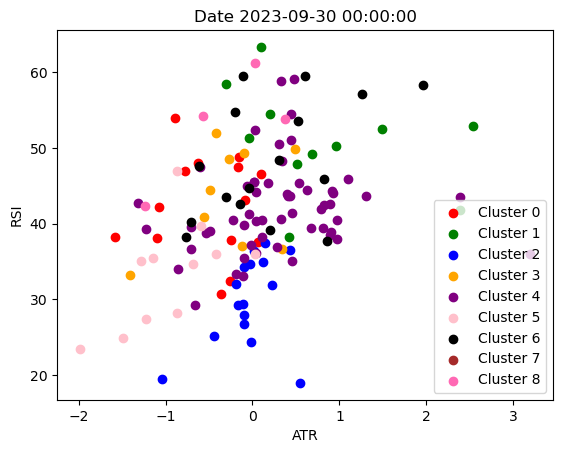

In [32]:
plot_clusters_by_date(num_clusters=9)

In [33]:
date_to_optimize_9 = extract_highest_rsi_clusters_each_month(num_clusters=9)

{'2017-11-01': ['AAPL',
  'ABT',
  'AMAT',
  'AMZN',
  'CAT',
  'CSCO',
  'DD',
  'DG',
  'DLTR',
  'EA',
  'GM',
  'ILMN',
  'INTC',
  'JNJ',
  'LOW',
  'MAR',
  'MSFT',
  'MU',
  'NKE',
  'NVDA',
  'TGT',
  'TXN',
  'WMT'],
 '2017-12-01': ['AZO',
  'BA',
  'BKNG',
  'ELV',
  'ILMN',
  'NVDA',
  'ORLY',
  'STZ',
  'UNH'],
 '2018-01-01': ['FCX'],
 '2018-02-01': ['AZO',
  'BA',
  'BKNG',
  'BRK-B',
  'CHTR',
  'EA',
  'ELV',
  'FDX',
  'HUM',
  'LMT',
  'NFLX',
  'ORLY',
  'TMO',
  'UNH'],
 '2018-03-01': ['BA', 'BKNG', 'BMY', 'EA', 'NFLX', 'NVDA'],
 '2018-04-01': ['DG', 'ILMN', 'INTC', 'MU', 'NKE', 'TGT'],
 '2018-05-01': ['BA', 'BKNG', 'CMG', 'ELV', 'NFLX', 'NVDA', 'ULTA', 'UNH'],
 '2018-06-01': ['AAPL',
  'ABT',
  'AMGN',
  'AMT',
  'EXPE',
  'GM',
  'INTC',
  'LLY',
  'LOW',
  'MDT',
  'MRK',
  'MU',
  'NKE',
  'TGT',
  'TJX',
  'TXN'],
 '2018-07-01': ['AMGN',
  'AMT',
  'BMY',
  'DG',
  'EXPE',
  'ILMN',
  'KR',
  'LLY',
  'LOW',
  'MRK',
  'NKE',
  'PEP',
  'PG',
  'TGT',
  'TJX',
 

## Portfolio Optimization

In [35]:
from pypfopt.efficient_frontier import EfficientFrontier
import pypfopt.base_optimizer
from pypfopt import risk_models
from pypfopt import expected_returns

def optimize_weights(prices, lower_bound=0):
    """
    Optimize portfolio weights to maximize the Sharpe ratio.
    Parameters:
    - prices (DataFrame or Series): Historical prices of assets.
    - lower_bound (float, optional): Lower bound for asset weights (default is 0).
    Returns:
    - dict: A dictionary of optimized asset weights for the portfolio.
    """
    returns = expected_returns.mean_historical_return(prices=prices, frequency=252)
    cov = risk_models.sample_cov(prices=prices, frequency=252)
    ef = EfficientFrontier(expected_returns=returns, cov_matrix=cov, weight_bounds=(lower_bound, 0.1), solver='SCS')
    weights = ef.max_sharpe()
    
    return ef.clean_weights()

In [36]:
"""
    Optimize the portfolio for a specific month and add the results to the portfolio DataFrame.
    Parameters:
    - portfolio_df (DataFrame): DataFrame to store portfolio optimization results.
    - fixed_dates (dict): A dictionary with dates as keys and lists of selected stocks as values.
    - start_date (str): The start date of the optimization period.
    - returns_dataframe (DataFrame): DataFrame containing asset returns over time.
    - cluster_num (int): The cluster number.
    Returns:
    - DataFrame: Updated portfolio DataFrame.
"""
def optimize_month(portfolio_df, fixed_dates, start_date, returns_dataframe, cluster_num):
    try:
        end_date = (pd.to_datetime(start_date)+pd.offsets.MonthEnd(0)).strftime('%Y-%m-%d')
        cols = fixed_dates[start_date]
        optimization_start_date = (pd.to_datetime(start_date)-pd.DateOffset(months=12)).strftime('%Y-%m-%d')
        optimization_end_date = (pd.to_datetime(start_date)-pd.DateOffset(days=1)).strftime('%Y-%m-%d')
        optimization_df = new_df[optimization_start_date:optimization_end_date]['Adj Close'][cols]
        success = False
        try:
            weights = optimize_weights(prices=optimization_df,
                                   lower_bound=round(1/(len(optimization_df.columns)*2),3))
            weights = pd.DataFrame(weights, index=pd.Series(0))
            success = True
        except:
            print(f'Max Sharpe Optimization failed for {start_date}, Continuing with Equal-Weights')
        
        if success==False:
            weights = pd.DataFrame([1/len(optimization_df.columns) for i in range(len(optimization_df.columns))],
                                     index=optimization_df.columns.tolist(),
                                     columns=pd.Series(0)).T
        
        temp_df = returns_dataframe[start_date:end_date]
        temp_df = temp_df.stack().to_frame('return').reset_index(level=0)\
                   .merge(weights.stack().to_frame('weight').reset_index(level=0, drop=True),
                          left_index=True,
                          right_index=True)\
                   .reset_index().set_index(['Date', 'index']).unstack().stack()
        temp_df.index.names = ['date', 'ticker']
        temp_df['weighted_return'] = temp_df['return']*temp_df['weight']
        col_name = 'Strategy Return_' + str(cluster_num)
        temp_df = temp_df.groupby(level=0)['weighted_return'].sum().to_frame(col_name)
        portfolio_df = pd.concat([portfolio_df, temp_df], axis=0)
    
    except Exception as e:
        print(e)
    return portfolio_df

In [37]:
def optimize_all(dates, new_df, cluster_num):
    """
    Optimize portfolios for all given start dates and cluster number.
    Parameters:
    - dates (dict): A dictionary with dates as keys and lists of selected stocks as values.
    - new_df (DataFrame): DataFrame containing asset data.
    - cluster_num (int): The cluster number.
    Returns:
    - DataFrame: DataFrame with optimized portfolio returns.
    """
    portfolio_df = pd.DataFrame()
    returns_dataframe = np.log(new_df['Adj Close']).diff()
    for start_date in dates.keys():
        portfolio_df = optimize_month(portfolio_df, dates, start_date, returns_dataframe, cluster_num)
    portfolio_df = portfolio_df.drop_duplicates()
    
    return portfolio_df

In [38]:
# import stock data
import yfinance as yf
stocks = data.index.get_level_values('ticker').unique().tolist()
new_df = yf.download(tickers=stocks,
                     start=data.index.get_level_values('date').unique()[0]-pd.DateOffset(months=12),
                     end=data.index.get_level_values('date').unique()[-1])

new_df

[*********************100%%**********************]  152 of 152 completed


Adj Close                                                 \
                  AAL        AAPL        ABBV        ABT         ACN   
Date                                                                   
2016-10-31  39.134327   26.316147   41.009075  34.630024  104.350311   
2016-11-01  38.363209   25.840998   41.501659  34.462334  104.260536   
2016-11-02  38.276463   25.864178   41.751625  34.153469  106.477890   
2016-11-03  38.054199   25.586948   41.089954  33.871052  104.987694   
2016-11-04  38.402081   25.356306   41.200230  34.497643  105.239059   
...               ...         ...         ...        ...         ...   
2023-09-25  12.910000  176.080002  153.117371  96.933411  315.680695   
2023-09-26  12.700000  171.960007  152.384705  95.700241  309.327057   
2023-09-27  12.610000  170.429993  151.612442  95.004089  313.081512   
2023-09-28  12.920000  170.690002  150.741165  97.579834  299.527710   
2023-09-29  12.810000  171.210007  147.582764  96.316818  305.841522   

                                                                       ...  \
                  ADBE         ADP        ADSK        AIG        AMAT  ...   
Date                                                                   ...   
2016-10-31  107.510002   75.138809   72.279999  51.253307   26.757374  ...   
2016-11-01  106.870003   75.017975   70.099998  50.406006   26.591751  ...   
2016-11-02  105.889999   77.658989   68.680000  50.298019   26.306515  ...   
2016-11-03  107.169998   77.097969   67.610001  48.304367   26.012070  ...   
2016-11-04  106.199997   76.882202   69.440002  47.664745   25.966057  ...   
...                ...         ...         ...        ...         ...  ...   
2023-09-25  511.600006  240.020004  205.669998  62.130001  136.589996  ...   
2023-09-26  506.299988  237.240005  201.660004  61.259998  134.080002  ...   
2023-09-27  502.600006  242.630005  202.279999  61.009998  135.059998  ...   
2023-09-28  504.670013  243.309998  207.889999  61.279999  138.220001  ...   
2023-09-29  509.899994  240.580002  206.910004  60.599998  138.449997  ...   

              Volume                                                           \
                   V      VLO     VRTX        VZ       WBA      WDC       WFC   
Date                                                                            
2016-10-31  10024000  4969500  1928200  12459400   4662100  3363200  20115900   
2016-11-01  10881500  7816800  2458200  13229400   5130800  3821100  20020200   
2016-11-02   9170900  7317600  2580400  16488200   9783100  4216200  19566600   
2016-11-03   7563100  3855900  2371000  12605100   4586500  3192600  14982700   
2016-11-04   7588100  3729900  1902100  14410200   7023900  2705600  27391600   
...              ...      ...      ...       ...       ...      ...       ...   
2023-09-25   5921600  3241900   698100  17616900   6891000  2685900  10624000   
2023-09-26   6193200  4936800   633600  18841600   7570500  3571100  15219400   
2023-09-27   6006700  3644000   860600  22083500  10182900  2547800  11815500   
2023-09-28   4203900  3587300   578900  18772100   7291500  3282000  12454600   
2023-09-29   6044200  4302200   896800  19759400  25659100  2512000  13119100   

                                        
                WMT     WYNN       XOM  
Date                                    
2016-10-31  6389000  1341600  16663800  
2016-11-01  8838600  3722300  13050600  
2016-11-02  7645300  2542400  11226100  
2016-11-03  6803900  9050400   8836500  
2016-11-04  7262100  3223800  13877100  
...             ...      ...       ...  
2023-09-25  3486500  1387800  11316000  
2023-09-26  4811900  1454000  11805400  
2023-09-27  5237000  2050000  23976200  
2023-09-28  3872400  1290400  16808100  
2023-09-29  6279300  1326800  18810700  

[1740 rows x 912 columns]

In [39]:
portfolio_df_3 = optimize_all(date_to_optimize_3, new_df, 3)
portfolio_df_3 

'return'


,Strategy Return_3
date,
2017-11-01,0.000791
2017-11-02,0.004097
2017-11-03,0.003906
2017-11-06,0.003206
2017-11-07,0.001720
...,...
2023-09-25,0.004380
2023-09-26,-0.011652
2023-09-27,0.004819


In [40]:
return_cluster_4 = optimize_all(date_to_optimize_4, new_df, 4)
portfolio_df_4 = pd.merge(portfolio_df_3, return_cluster_4, left_index = True, right_index = True)
portfolio_df_4

Max Sharpe Optimization failed for 2017-12-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-06-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2022-10-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2023-03-01, Continuing with Equal-Weights
'return'


,Strategy Return_3,Strategy Return_4
date,,
2017-11-01,0.000791,0.000476
2017-11-02,0.004097,0.002599
2017-11-03,0.003906,0.005196
2017-11-06,0.003206,-0.000655
2017-11-07,0.001720,0.002161
...,...,...
2023-09-25,0.004380,0.003718
2023-09-26,-0.011652,-0.012640
2023-09-27,0.004819,0.002196


In [41]:
return_cluster_5 = optimize_all(date_to_optimize_5, new_df, 5)
portfolio_df_5 = pd.merge(portfolio_df_4, return_cluster_5, left_index = True, right_index = True)
portfolio_df_5

Max Sharpe Optimization failed for 2017-12-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-06-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2022-10-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2023-03-01, Continuing with Equal-Weights
'return'


,Strategy Return_3,Strategy Return_4,Strategy Return_5
date,,,
2017-11-01,0.000791,0.000476,0.000476
2017-11-02,0.004097,0.002599,0.002599
2017-11-03,0.003906,0.005196,0.005196
2017-11-06,0.003206,-0.000655,-0.000655
2017-11-07,0.001720,0.002161,0.002161
...,...,...,...
2023-09-25,0.004380,0.003718,0.003718
2023-09-26,-0.011652,-0.012640,-0.012640
2023-09-27,0.004819,0.002196,0.002196


In [42]:
return_cluster_6 = optimize_all(date_to_optimize_6, new_df, 6)
portfolio_df_6 = pd.merge(portfolio_df_5, return_cluster_6, left_index = True, right_index = True)
portfolio_df_6

Max Sharpe Optimization failed for 2017-12-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-06-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2022-10-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2023-03-01, Continuing with Equal-Weights
'return'


,Strategy Return_3,Strategy Return_4,Strategy Return_5,Strategy Return_6
date,,,,
2017-11-01,0.000791,0.000476,0.000476,0.000476
2017-11-02,0.004097,0.002599,0.002599,0.002599
2017-11-03,0.003906,0.005196,0.005196,0.005196
2017-11-06,0.003206,-0.000655,-0.000655,-0.000655
2017-11-07,0.001720,0.002161,0.002161,0.002161
...,...,...,...,...
2023-09-25,0.004380,0.003718,0.003718,0.003718
2023-09-26,-0.011652,-0.012640,-0.012640,-0.012640
2023-09-27,0.004819,0.002196,0.002196,0.002196


In [43]:
return_cluster_7 = optimize_all(date_to_optimize_7, new_df, 7)
portfolio_df_7 = pd.merge(portfolio_df_6, return_cluster_7, left_index = True, right_index = True)
portfolio_df_7

Max Sharpe Optimization failed for 2017-12-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-06-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-11-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2022-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2022-10-01, Continuing with Equal-Weights

,Strategy Return_3,Strategy Return_4,Strategy Return_5,Strategy Return_6,Strategy Return_7
date,,,,,
2017-11-01,0.000791,0.000476,0.000476,0.000476,0.001698
2017-11-02,0.004097,0.002599,0.002599,0.002599,0.000287
2017-11-03,0.003906,0.005196,0.005196,0.005196,0.005983
2017-11-06,0.003206,-0.000655,-0.000655,-0.000655,-0.002234
2017-11-07,0.001720,0.002161,0.002161,0.002161,0.002310
...,...,...,...,...,...
2023-09-25,0.004380,0.003718,0.003718,0.003718,0.003718
2023-09-26,-0.011652,-0.012640,-0.012640,-0.012640,-0.012640
2023-09-27,0.004819,0.002196,0.002196,0.002196,0.002196


In [44]:
return_cluster_8 = optimize_all(date_to_optimize_8, new_df, 8)
portfolio_df_8 = pd.merge(portfolio_df_7, return_cluster_8, left_index = True, right_index = True)
portfolio_df_8

Max Sharpe Optimization failed for 2017-12-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-09-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-10-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-06-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-02-01, Continuing with Equal-Weights

,Strategy Return_3,Strategy Return_4,Strategy Return_5,Strategy Return_6,Strategy Return_7,Strategy Return_8
date,,,,,,
2017-11-01,0.000791,0.000476,0.000476,0.000476,0.001698,0.001698
2017-11-02,0.004097,0.002599,0.002599,0.002599,0.000287,0.000287
2017-11-03,0.003906,0.005196,0.005196,0.005196,0.005983,0.005983
2017-11-06,0.003206,-0.000655,-0.000655,-0.000655,-0.002234,-0.002234
2017-11-07,0.001720,0.002161,0.002161,0.002161,0.002310,0.002310
...,...,...,...,...,...,...
2023-09-25,0.004380,0.003718,0.003718,0.003718,0.003718,0.014030
2023-09-26,-0.011652,-0.012640,-0.012640,-0.012640,-0.012640,-0.009665
2023-09-27,0.004819,0.002196,0.002196,0.002196,0.002196,0.020527


In [45]:
return_cluster_9 = optimize_all(date_to_optimize_9, new_df, 9)
portfolio_df_9 = pd.merge(portfolio_df_8, return_cluster_9, left_index = True, right_index = True)
portfolio_df_9

Max Sharpe Optimization failed for 2017-12-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-03-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-09-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2018-10-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-04-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-05-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2019-06-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-01-01, Continuing with Equal-Weights
Max Sharpe Optimization failed for 2020-02-01, Continuing with Equal-Weights

,Strategy Return_3,Strategy Return_4,Strategy Return_5,Strategy Return_6,Strategy Return_7,Strategy Return_8,Strategy Return_9
date,,,,,,,
2017-11-01,0.000791,0.000476,0.000476,0.000476,0.001698,0.001698,0.001698
2017-11-02,0.004097,0.002599,0.002599,0.002599,0.000287,0.000287,0.000287
2017-11-03,0.003906,0.005196,0.005196,0.005196,0.005983,0.005983,0.005983
2017-11-06,0.003206,-0.000655,-0.000655,-0.000655,-0.002234,-0.002234,-0.002234
2017-11-07,0.001720,0.002161,0.002161,0.002161,0.002310,0.002310,0.002310
...,...,...,...,...,...,...,...
2023-09-25,0.004380,0.003718,0.003718,0.003718,0.003718,0.014030,0.014030
2023-09-26,-0.011652,-0.012640,-0.012640,-0.012640,-0.012640,-0.009665,-0.009665
2023-09-27,0.004819,0.002196,0.002196,0.002196,0.002196,0.020527,0.020527


## Comparing against S&P500 Buy and Hold strategy

In [46]:
spy = yf.download(tickers='SPY',
                  start='2015-01-01',
                  end=dt.date.today())

spy_ret = np.log(spy[['Adj Close']]).diff().dropna().rename({'Adj Close':'SPY Buy&Hold'}, axis=1)

portfolio_df_final = portfolio_df_9.merge(spy_ret,
                                  left_index=True,
                                  right_index=True)

portfolio_df_final

[*********************100%%**********************]  1 of 1 completed


,Strategy Return_3,Strategy Return_4,Strategy Return_5,Strategy Return_6,Strategy Return_7,Strategy Return_8,Strategy Return_9,SPY Buy&Hold
2017-11-01,0.000791,0.000476,0.000476,0.000476,0.001698,0.001698,0.001698,0.001321
2017-11-02,0.004097,0.002599,0.002599,0.002599,0.000287,0.000287,0.000287,0.000388
2017-11-03,0.003906,0.005196,0.005196,0.005196,0.005983,0.005983,0.005983,0.003333
2017-11-06,0.003206,-0.000655,-0.000655,-0.000655,-0.002234,-0.002234,-0.002234,0.001546
2017-11-07,0.001720,0.002161,0.002161,0.002161,0.002310,0.002310,0.002310,-0.000696
...,...,...,...,...,...,...,...,...
2023-09-25,0.004380,0.003718,0.003718,0.003718,0.003718,0.014030,0.014030,0.004196
2023-09-26,-0.011652,-0.012640,-0.012640,-0.012640,-0.012640,-0.009665,-0.009665,-0.014800
2023-09-27,0.004819,0.002196,0.002196,0.002196,0.002196,0.020527,0.020527,0.000399
2023-09-28,0.008849,0.006238,0.006238,0.006238,0.006238,0.008408,0.008408,0.005781


In [47]:
# function to calculate geometric mean returns
def calculate_geo_mean(df):
    geo_mean = (df+1).prod()**(1/df.shape[0]) - 1
    return geo_mean

# function to calculate annualized volatility 
def calculate_annul_vol(df):
    annul_vol = df.std()*np.sqrt(252)
    return annul_vol

def calculate_downside_std_dev(df):
    downside_diff = np.clip(df, np.NINF, 0) # remove positive returns 
    np.square(downside_diff, out=downside_diff)
    annualized_downside_std_dev = np.sqrt(downside_diff.mean()) * np.sqrt(252)

    return annualized_downside_std_dev

# function to calculate annulized returns
def calculate_annul_ret(df):
    returns_per_day = calculate_geo_mean(df)
    annul_ret = (returns_per_day+1)**252-1
    return annul_ret

# function to calculate max % drawdown
def calculate_max_drawdown(return_series): 
    wealth_index = (1+return_series).cumprod()
    previous_peaks = wealth_index.cummax()
    drawdowns = (wealth_index - previous_peaks) / previous_peaks
    return drawdowns.min()

# def calculate_beta(daily_portfolio_returns, daily_benchmark_returns, risk_free_rate=0.02):
#     risk_free_rate = riskfree_rate*np.sqrt(252) # convert to daily
#     excess_returns = daily_portfolio_returns - risk_free_rate
#     excess_benchmark_returns = daily_benchmark_returns - risk_free_rate
#     beta = np.cov(excess_returns, excess_benchmark_returns)[0, 1] / np.var(excess_benchmark_returns)
#     return beta

# def calculate_alpha(anul_portfolio_returns, anul_benchmark_returns, beta, riskfree_rate=0.02):
#     return anul_portfolio_returns - (riskfree_rate + beta*(anul_benchmark_returns - riskfree_rate))

# function to calculate sharpe ratio
def calculate_sharpe_ratio(annualized_return, annualized_vol, riskfree_rate=0.02):
    return (annualized_return - riskfree_rate)/annualized_vol
    
# function to calculate calmar ratio
def calculate_calmar_ratio(annualized_return, max_drawdown, riskfree_rate=0.02):
    return (annualized_return - riskfree_rate)/max_drawdown

# function to calculate sortino ratio
def calculate_sortino_ratio(annualized_return, annualized_downside_std_dev, riskfree_rate = 0.02):
    return (annualized_return - riskfree_rate)/annualized_downside_std_dev

In [48]:
# Create a list of 'k' values
k_values = [3, 4, 5, 6, 7, 8, 9]

# Create a dictionary to store the metrics
metrics_dict = {}

# Loop through the 'k' values
for k in k_values:
    strategy_return = portfolio_df_final[f'Strategy Return_{k}']
    
    # Calculate metrics
    anul_vol = calculate_annul_vol(strategy_return)
    downside_std_dev = calculate_downside_std_dev(strategy_return)
    anul_ret = calculate_annul_ret(strategy_return)
    max_pct_drawdown = calculate_max_drawdown(strategy_return)
    sharpe_ratio = calculate_sharpe_ratio(anul_ret, anul_vol)
    sortino_ratio = calculate_sortino_ratio(anul_ret, downside_std_dev)
    calmar_ratio = calculate_calmar_ratio(anul_ret, max_pct_drawdown)

    # Store metrics in the dictionary
    metrics_dict[f'k = {k}'] = [anul_ret, anul_vol, downside_std_dev, max_pct_drawdown, sharpe_ratio, sortino_ratio, abs(calmar_ratio)]

# Calculate metrics for 'SPY Buy & Hold' strategy
spy_return = portfolio_df_final['SPY Buy&Hold']
anul_vol_spy = calculate_annul_vol(spy_return)
downside_std_dev_spy = calculate_downside_std_dev(spy_return)
anul_ret_spy = calculate_annul_ret(spy_return)
max_pct_drawdown_spy = calculate_max_drawdown(spy_return)
sharpe_ratio_spy = calculate_sharpe_ratio(anul_ret_spy, anul_vol_spy)
sortino_ratio_spy = calculate_sortino_ratio(anul_ret_spy, downside_std_dev_spy)
calmar_ratio_spy = calculate_calmar_ratio(anul_ret_spy, max_pct_drawdown_spy)

# Store metrics for 'SPY Buy & Hold' in the dictionary
metrics_dict['SPY Buy & Hold'] = [anul_ret_spy, anul_vol_spy, downside_std_dev_spy, max_pct_drawdown_spy, sharpe_ratio_spy, sortino_ratio_spy, abs(calmar_ratio_spy)]

# create DataFrame to store values for better visualization
metrics_df = pd.DataFrame(metrics_dict, index = ['Annualized Returns',
                                                 'Annualized Volatility',
                                                 'Downside Standard Dev',
                                                 'Max % Drawdown',
                                                 'Sharpe Ratio',
                                                 'Sortino Ratio',
                                                 'Calmar Ratio'])

metrics_df

,k = 3,k = 4,k = 5,k = 6,k = 7,k = 8,k = 9,SPY Buy & Hold
Annualized Returns,0.100704,0.045498,0.045498,0.045498,0.062773,0.121419,0.074675,0.085671
Annualized Volatility,0.227102,0.207211,0.207211,0.207211,0.215308,0.386604,0.387010,0.204864
Downside Standard Dev,0.168825,0.151859,0.151859,0.151859,0.156604,0.270653,0.272404,0.150440
Max % Drawdown,-0.364674,-0.357938,-0.357938,-0.357938,-0.333816,-0.557110,-0.557110,-0.357459
Sharpe Ratio,0.355367,0.123055,0.123055,0.123055,0.198659,0.262332,0.141274,0.320558
Sortino Ratio,0.478036,0.167908,0.167908,0.167908,0.273127,0.374719,0.200711,0.436526
Calmar Ratio,0.221306,0.071237,0.071237,0.071237,0.128133,0.182044,0.098140,0.183716


In [49]:
# # Print the metrics
# for key, values in metrics_dict.items():
#     print(key)
#     print(f"Annualized Vol: {values[1]}")
#     print(f"Annualized Downside Vol: {values[2]}")
#     print(f"Annualized Ret: {values[0]}")
#     print(f"Max % Drawdown: {values[3]}")
#     print(f"Annualized Sharpe Ratio: {values[4]}")
#     print(f"Annualized Sortino Ratio: {values[5]}")
#     print(f"Annualized Calmar Ratio: {values[6]}")
#     print('------------------------------------------------')

<Axes: >

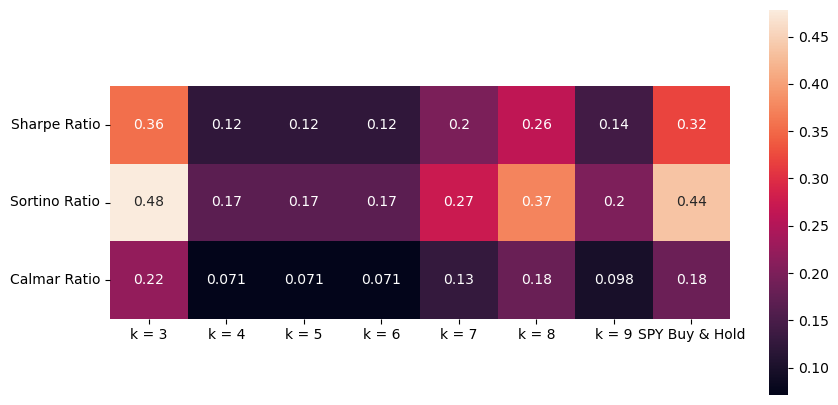

In [50]:
# Show a heatmap of ratios
plt.figure(figsize = (10,5))
sns.heatmap(metrics_df.loc['Sharpe Ratio':'Calmar Ratio',:], annot=True, square = True)

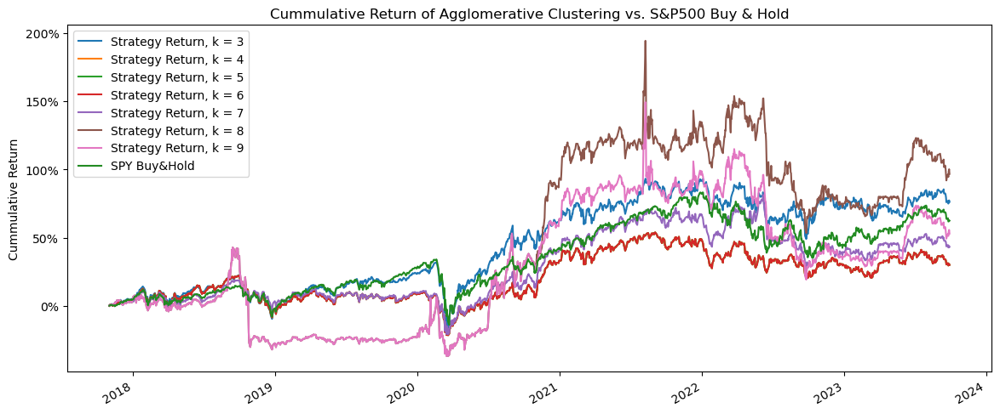

In [51]:
# Create a list of 'k' values
k_values = [3, 4, 5, 6, 7, 8, 9]


# Plot cumulative returns for each portfolio
for k in k_values:
    portfolio_return = portfolio_df_final[f'Strategy Return_{k}']
    portfolio_cumulative_return = np.exp(np.log1p(portfolio_return).cumsum()) - 1
    portfolio_cumulative_return.plot(fontsize = 10, figsize=(16, 10), label=f'Strategy Return, k = {k}')

# Plot cumulative returns for 'SPY Buy & Hold' portfolio
spy_return = portfolio_df_final['SPY Buy&Hold']
spy_cumulative_return = np.exp(np.log1p(spy_return).cumsum()) - 1
spy_cumulative_return.plot(fontsize = 10, figsize=(14, 6), label='SPY Buy&Hold', color='forestgreen')

plt.title('Cummulative Return of Agglomerative Clustering vs. S&P500 Buy & Hold')
plt.legend(fontsize='10')
plt.gca().yaxis.set_major_formatter(mtick.PercentFormatter(1))
plt.ylabel('Cummulative Return')
plt.show()

## Comparing Results of 2 Clustering Methods

In [52]:
# Import result of K-Mean Return when k=6
kmeans_df = pd.read_excel('k=6.xlsx')
kmeans_df.set_index('date', inplace=True)
kmeans_df.drop(columns=['Strategy Return_3','Strategy Return_4','Strategy Return_5'],inplace=True)
kmeans_df.rename(columns={'Strategy Return_6': 'K-Means Return, k=6'}, inplace=True)

In [83]:
# Rename return column of Agglomerative when k=3
agglo_df = portfolio_df_3.rename(columns={'Strategy Return_3': 'Agglomerative Return, k=3'})

# Merge result of 2 models and SP500 to plot
merged_return_df = pd.merge(kmeans_df, agglo_df, left_index=True, right_index=True)
merged_return_df = pd.merge(merged_return_df, portfolio_df_final['SPY Buy&Hold'], left_index=True, right_index=True)
merged_return_df

,"K-Means Return, k=6","Agglomerative Return, k=3",SPY Buy&Hold
date,,,
2017-11-01,0.004600,0.000791,0.001321
2017-11-02,0.000594,0.004097,0.000388
2017-11-03,0.007479,0.003906,0.003333
2017-11-06,0.002738,0.003206,0.001546
2017-11-07,0.003365,0.001720,-0.000696
...,...,...,...
2023-09-25,0.002029,0.004380,0.004196
2023-09-26,-0.011722,-0.011652,-0.014800
2023-09-27,0.004478,0.004819,0.000399


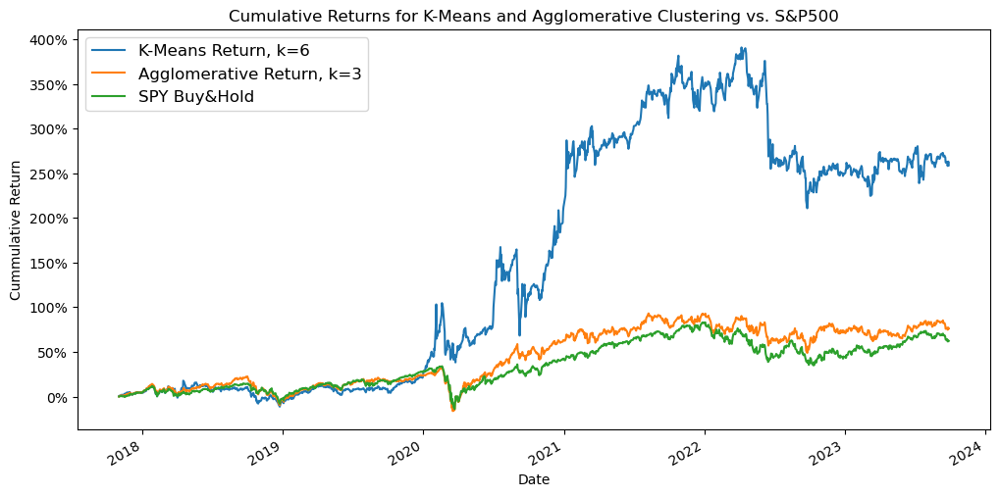

In [84]:
# Plot cumulative returns of Agglomerative:
agglomerative_return = np.exp(np.log1p(merged_return_df['K-Means Return, k=6']).cumsum()) - 1
agglomerative_return.plot(figsize=(12, 6), label='K-Means Return, k=6')

# Plot cumulative returns of K-Means:
kmeans_return = np.exp(np.log1p(merged_return_df['Agglomerative Return, k=3']).cumsum()) - 1
kmeans_return.plot(label='Agglomerative Return, k=3')

# Plot cumulative returns for 'SPY Buy & Hold' portfolio
spx_return = np.exp(np.log1p(merged_return_df['SPY Buy&Hold']).cumsum()) - 1
spx_return.plot(label='SPY Buy&Hold')

plt.title('Cumulative Returns for K-Means and Agglomerative Clustering vs. S&P500')
plt.legend(fontsize='12', loc = 'upper left')
plt.gca().yaxis.set_major_formatter(mtick.PercentFormatter(1))
plt.ylabel('Cummulative Return')
plt.xlabel('Date')

plt.show()

In [91]:
# Create a dictionary to store the metrics of 2 models
comparison_metrics = {}

# List of strategies and their corresponding columns in merged_return_df
strategies = [('K-Means Return, k=6', 'K-Means, k=6'),
              ('Agglomerative Return, k=3', 'Agglomerative, k=3'),
               ('SPY Buy&Hold', 'SPY Buy&Hold')]

for strategy, strategy_rename in strategies:
    strategy_metrics = merged_return_df[strategy]
    
    # Calculate metrics
    anul_vol = calculate_annul_vol(strategy_metrics)
    downside_std_dev = calculate_downside_std_dev(strategy_metrics)
    anul_ret = calculate_annul_ret(strategy_metrics)
    max_pct_drawdown = calculate_max_drawdown(strategy_metrics)
    
    sharpe_ratio = calculate_sharpe_ratio(anul_ret, anul_vol)
    sortino_ratio = calculate_sortino_ratio(anul_ret, downside_std_dev)
    calmar_ratio = calculate_calmar_ratio(anul_ret, max_pct_drawdown)
    
    # Store metrics in the dictionary
    comparison_metrics[strategy_rename] = [anul_vol, anul_ret, downside_std_dev, max_pct_drawdown, sharpe_ratio, sortino_ratio, abs(calmar_ratio)]
    
# Create a DataFrame to store values for better visualization
comparison_metrics_df = pd.DataFrame(comparison_metrics, index=['Annualized Returns',
                                                                'Annualized Volatility',
                                                                'Downside Standard Dev',
                                                                'Max % Drawdown',
                                                                'Sharpe Ratio',
                                                                'Sortino Ratio',
                                                                'Calmar Ratio'])


comparison_metrics_df


,"K-Means, k=6","Agglomerative, k=3",SPY Buy&Hold
Annualized Returns,0.348629,0.227102,0.204864
Annualized Volatility,0.241837,0.100704,0.085671
Downside Standard Dev,0.243015,0.168825,0.150440
Max % Drawdown,-0.370571,-0.364674,-0.357459
Sharpe Ratio,0.636313,0.355367,0.320558
Sortino Ratio,0.912854,0.478036,0.436526
Calmar Ratio,0.598635,0.221306,0.183716
